# Projeto 1: Interpretabilidade de Modelos 
# Aluno: Victor Gabriel Ferreira Barbosa

# Carregando base de dados

In [267]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

Inicialmente será realizada a leitura do arquivo CSV contendo os dados a serem analisados.

In [2]:
df = pd.read_csv("hotel_bookings.csv")

In [3]:
df


,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.00,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.00,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.00,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.00,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.00,0,1,Check-Out,2015-07-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119385,City Hotel,0,23,2017,August,35,30,2,5,2,...,No Deposit,394.0,NaN,0,Transient,96.14,0,0,Check-Out,2017-09-06
119386,City Hotel,0,102,2017,August,35,31,2,5,3,...,No Deposit,9.0,NaN,0,Transient,225.43,0,2,Check-Out,2017-09-07
119387,City Hotel,0,34,2017,August,35,31,2,5,2,...,No Deposit,9.0,NaN,0,Transient,157.71,0,4,Check-Out,2017-09-07
119388,City Hotel,0,109,2017,August,35,31,2,5,2,...,No Deposit,89.0,NaN,0,Transient,104.40,0,0,Check-Out,2017-09-07


# Descrição da base de dados

A base de dados escolhida contém informações referentes a reservas em hoteis. O objetivo do trabalho será treinar e analisar modelos preditivos para identificar se o cliente cancelou a reserva.

Os dados foram obtidos do Kaggle:

https://www.kaggle.com/datasets/jessemostipak/hotel-booking-demand/data

Abaixo são descritas todas as informações presentes na base de dados:

- is_canceled (variável alvo): Indica se a reserva foi cancelada (1) ou não (0).
- hotel: Indica se é um resort ou um hotel na cidade.
- lead_time: Número de dias que se passaram entre a data de entrada da reserva no PMS (Property Management System) e a data de chegada.
- arrival_date_year: Ano da data de chegada.
- arrival_date_month: Mês da data de chegada.
- arrival_date_week_number: Número da semana do ano da data de chegada.
- arrival_date_day_of_month: Dia da data de chegada.
- stays_in_weekend_nights: Número de noites de fim de semana (sábado ou domingo) que o hóspede ficou ou reservou para ficar no hotel.
- stays_in_week_nights: Número de noites de semana (segunda a sexta) que o hóspede ficou ou reservou para ficar no hotel.
- adults: Número de adultos.
- children: Número de crianças.
- babies: Número de bebês.
- meal: Tipo de refeição reservada. As categorias são: Undefined/SC – sem pacote de refeições; BB – café da manhã; HB – café da manhã e mais uma refeição, geralmente jantar; FB – café da manhã, almoço e jantar.
- country: País de origem. As categorias são representadas no formato ISO 3155–3:2013.
- market_segment: Designação de segmento de mercado. Nas categorias, o termo "TA" significa "Agentes de Viagens" e "TO" significa "Operadores Turísticos".
- distribution_channel: Canal de distribuição de reservas. O termo "TA" significa "Agentes de Viagens" e "TO" significa "Operadores Turísticos".
- is_repeated_guest: Valor indicando se o nome da reserva era de um hóspede repetido (1) ou não (0).
- previous_cancellations: Número de reservas anteriores que foram canceladas pelo cliente antes da reserva atual.
- previous_bookings_not_canceled: Número de reservas anteriores não canceladas pelo cliente antes da reserva atual.
- reserved_room_type: Código do tipo de quarto reservado. 
- assigned_room_type: Código para o tipo de quarto atribuído à reserva. As vezes, o tipo de quarto atribuído difere do tipo de quarto reservado devido a razões de operação do hotel, por exemplo, lotação, ou a pedido do cliente. 
- booking_changes: Número de alterações realizadas na reserva desde o momento em que a reserva foi inserida no PMS até o momento do check-in ou cancelamento.
- deposit_type: Indicação se o cliente fez um depósito para garantir a reserva. Esta variável pode assumir três categorias: No Deposit – nenhum depósito foi feito; Non Refund – foi feito um depósito no valor do custo total da estadia; Refundable – foi feito um depósito com um valor inferior ao custo total da estadia.
- agent: Identificador da agência de viagens que fez a reserva.
- company: Identificador da empresa/entidade que fez a reserva ou responsável por pagar a reserva.
- days_in_waiting_list: Número de dias que a reserva ficou na lista de espera antes de ser confirmada ao cliente.
- customer_type: Tipo de reserva, assumindo uma de quatro categorias: Contract  - quando a reserva tem um lote ou outro tipo de contrato associado a ela; Group – quando a reserva está associada a um grupo; Transient – quando a reserva não faz parte de um grupo ou contrato e não está associada a outra reserva transiente; Transient-Party – quando a reserva é transiente, mas está associada a pelo menos outra reserva transiente.
- adr: Tarifa Média Diária definida pela divisão da soma de todas as transações de hospedagem pelo total de noites de estadia
- required_car_parking_spaces: Número de vagas de estacionamento solicitadas pelo cliente
- total_of_special_requests: Número de pedidos especiais feitos pelo cliente, por exemplo, cama de solteiro.
- reservation_status: Último status da reserva, assumindo uma de três categorias: Canceled – reserva foi cancelada pelo cliente; Check-Out – cliente fez o check-in, mas já partiu; No-Show – cliente não fez o check-in e não informou o hotel do motivo.
- reservation_status_date: Data em que o último status foi definido. 

# Analisando variáveis

## Analisando os tipos das variáveis

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

A variável "children" foi reconhecida como float embora possua apenas valores inteiros, visto que correponde a quantidade de crianças, desta forma é realiza a conversão para inteiro.

In [5]:
df["children"].unique()

array([ 0.,  1.,  2., 10.,  3., nan])

In [6]:
df["children"] = df["children"].astype("Int64")

## Analisando a presença de valores nulos

In [7]:
df.isna().sum()


hotel                                  0
is_canceled                            0
lead_time                              0
arrival_date_year                      0
arrival_date_month                     0
arrival_date_week_number               0
arrival_date_day_of_month              0
stays_in_weekend_nights                0
stays_in_week_nights                   0
adults                                 0
children                               4
babies                                 0
meal                                   0
country                              488
market_segment                         0
distribution_channel                   0
is_repeated_guest                      0
previous_cancellations                 0
previous_bookings_not_canceled         0
reserved_room_type                     0
assigned_room_type                     0
booking_changes                        0
deposit_type                           0
agent                              16340
company         

Foi identificada a presença de valores nulos em 4 variáveis, "children", "country", "agent" e "company".

As variáveis agent e company serão removidas pois possuem muitos valores nulos e se tratam de identificadores.

In [8]:
df = df.drop(columns=["agent", "company"])


A variável country será removida devida a grande quantidade de valores distintos e também por possuir valores nulos

In [9]:
df["country"].nunique()

177

In [10]:
df = df.drop(columns=["country"])


Os registros que possuem a variável children nulas serão removidos devida a baixa quantidade (4).

In [11]:
df = df[df["children"].notna()]

Como verificado abaixo todos os valores nulos foram removidos.

In [12]:
df.isna().sum().sum()

0

## Analisando variáveis categoricas

### is_canceled

A variável alvo "is_canceled" possui uma maior quantidade de 0.

<Axes: xlabel='count', ylabel='is_canceled'>

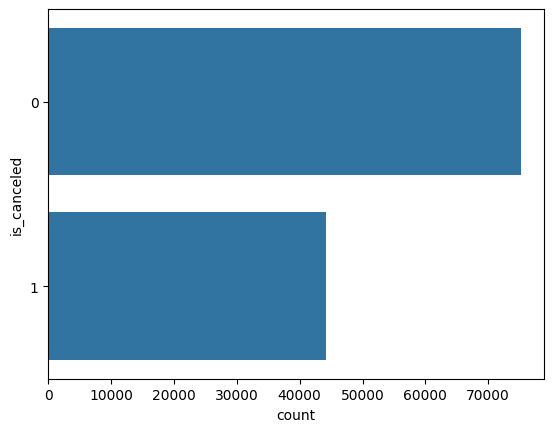

In [13]:
sns.countplot(df, y = "is_canceled")

### hotel

A base de dados possui mais exemplos de hoteis de cidades.

<Axes: xlabel='count', ylabel='hotel'>

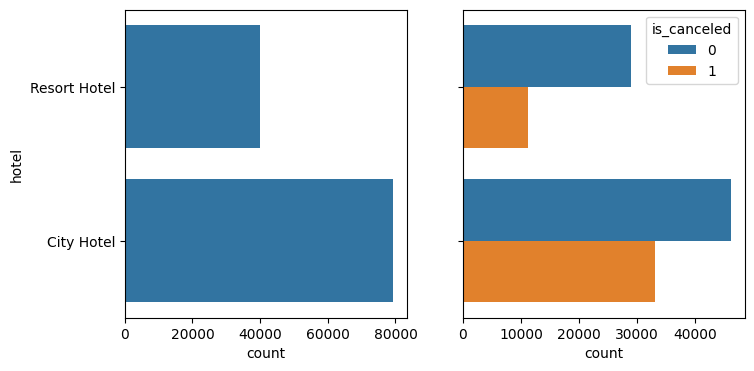

In [14]:
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(8, 4))
sns.countplot(df, y="hotel",ax=ax1)
sns.countplot(df, y="hotel", hue="is_canceled", ax=ax2)


### meal

Os clientes em sua grande maioria solicitam apenas o café da manhã (BB) e uma pequena quantidade solicita o pacote completo (FBhotel).

<Axes: xlabel='count', ylabel='meal'>

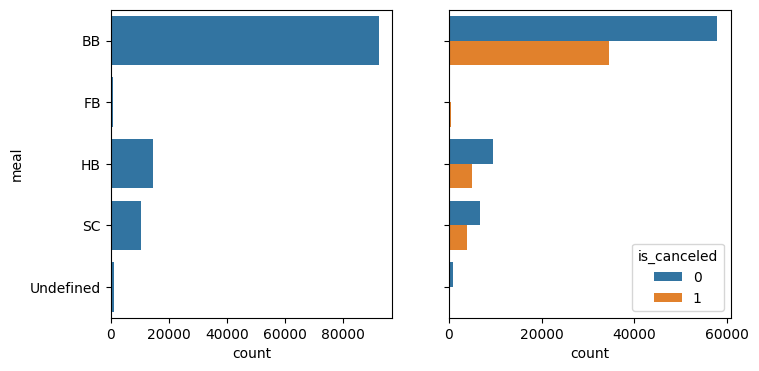

In [15]:
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(8, 4))
sns.countplot(df, y="meal",ax=ax1)
sns.countplot(df, y="meal", hue="is_canceled", ax=ax2)

### market_segment

A maior parte das reservas são realizadas por agências onlines e observa-se que as reservas realizadas por grupos possuem mais cancelamentos que confirmações.

<Axes: xlabel='count', ylabel='market_segment'>

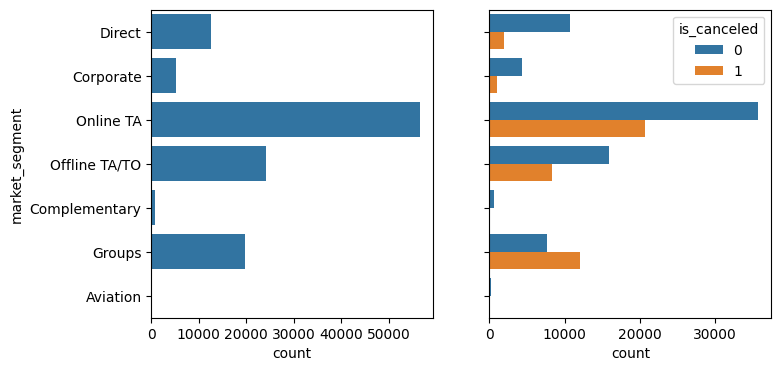

In [16]:
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(8, 4))
sns.countplot(df, y="market_segment",ax=ax1)
sns.countplot(df, y="market_segment", hue="is_canceled", ax=ax2)

### distribution_channel

As reservas são realizadas majoritariamente em agências de viagens

<Axes: xlabel='count', ylabel='distribution_channel'>

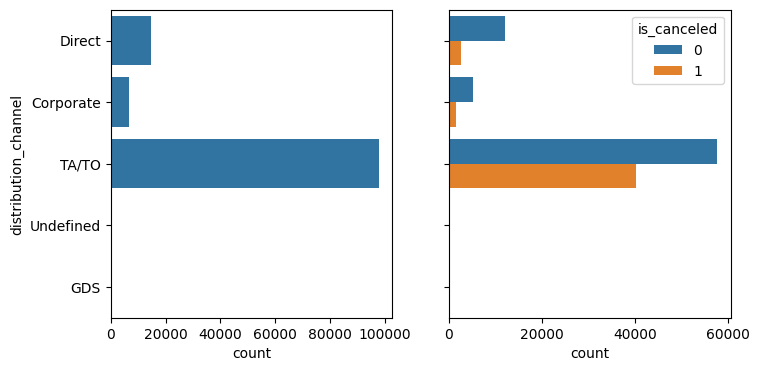

In [17]:
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(8, 4))
sns.countplot(df, y="distribution_channel",ax=ax1)
sns.countplot(df, y="distribution_channel", hue="is_canceled", ax=ax2)

### reserved_room_type

Os clientes majoritariamente realizam reservas nos quartos do tipo A.

<Axes: xlabel='count', ylabel='reserved_room_type'>

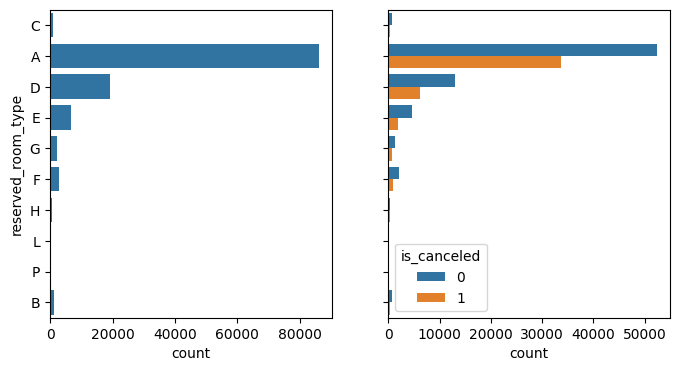

In [18]:
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(8, 4))
sns.countplot(df, y="reserved_room_type",ax=ax1)
sns.countplot(df, y="reserved_room_type", hue="is_canceled", ax=ax2)

### assigned_room_type

Embora uma grande quantidade de clientes são atribuidos aos quartos do tipo A, observa-se uma diminuição quando comparado com a quantidade de clientes que solicitaram esse quarto na reserva, assim, esses clientes tiveram um tipo de quarto atribuido diferente do solicitado, o que pode ser observado no aumento de atribuição ao quarto do tipo D em relação a quantidade de solicitação a esse tipo durante a reserva.

<Axes: xlabel='count', ylabel='assigned_room_type'>

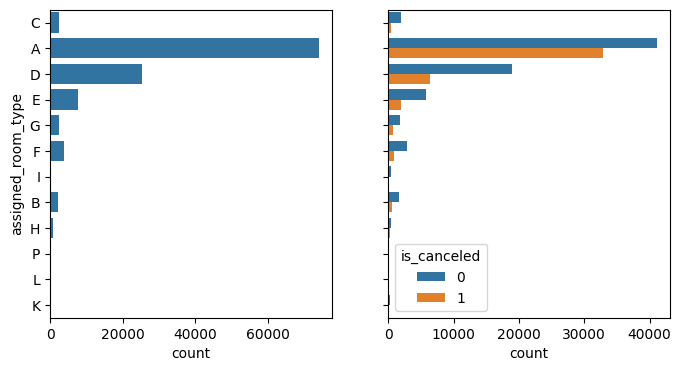

In [19]:
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(8, 4))
sns.countplot(df, y="assigned_room_type",ax=ax1)
sns.countplot(df, y="assigned_room_type", hue="is_canceled", ax=ax2)

In [20]:
len(df[df["reserved_room_type"] == "A"]) - len(df[df["assigned_room_type"] == "A"])

11941

Cerca de 12 mil clientes que reservaram o quarto A tiverem outro quarto atribuido.

### deposit_type

A maior parte dos clientes não realizam depositos para garantir a reserva e entre os clientes que realizam um deposito no valor do custo total da estadia, 99% realizaram o cancelamento.

<Axes: xlabel='count', ylabel='deposit_type'>

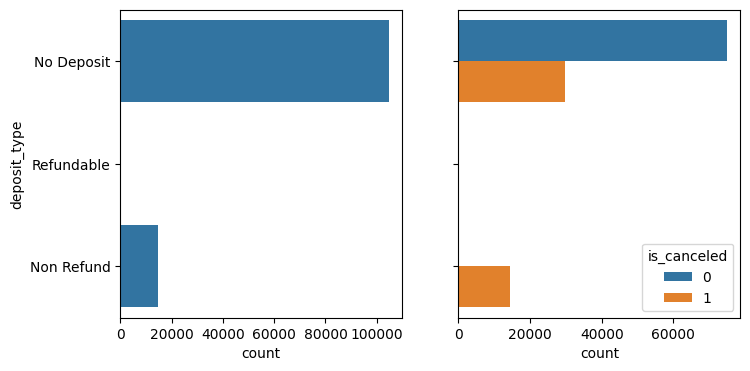

In [21]:
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(8, 4))
sns.countplot(df, y="deposit_type",ax=ax1)
sns.countplot(df, y="deposit_type", hue="is_canceled", ax=ax2)

In [22]:
df[df["deposit_type"] == "Non Refund"]["is_canceled"].value_counts()

1    14494
0       93
Name: is_canceled, dtype: int64

In [23]:
len(df[(df["deposit_type"] == "Non Refund") & (df["is_canceled"] == 1)]) / len(df[(df["deposit_type"] == "Non Refund")]) *100 

99.36244601357373

### customer_type

As reservas em sua maioria não são parte de um grupo ou contrato (Transient e Transient-Party)

<Axes: xlabel='count', ylabel='customer_type'>

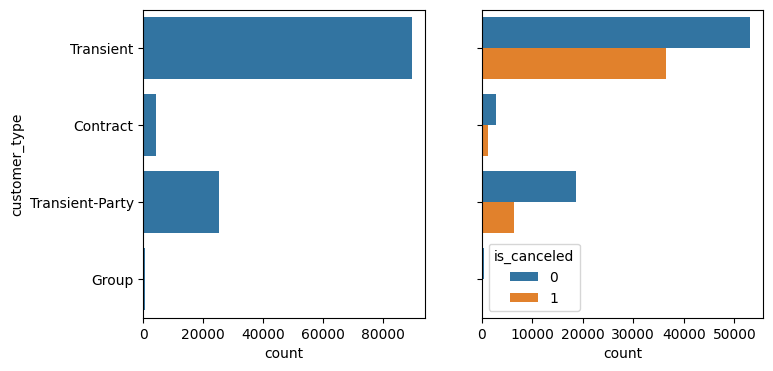

In [24]:
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(8, 4))
sns.countplot(df, y="customer_type",ax=ax1)
sns.countplot(df, y="customer_type", hue="is_canceled", ax=ax2)

### reservation_status

O status da reserva indica se o cancelamento foi informado pelo cliente ou ele não apareceu, como essa variável informa se a reserva foi cancelada, ela será removida.

<Axes: xlabel='count', ylabel='reservation_status'>

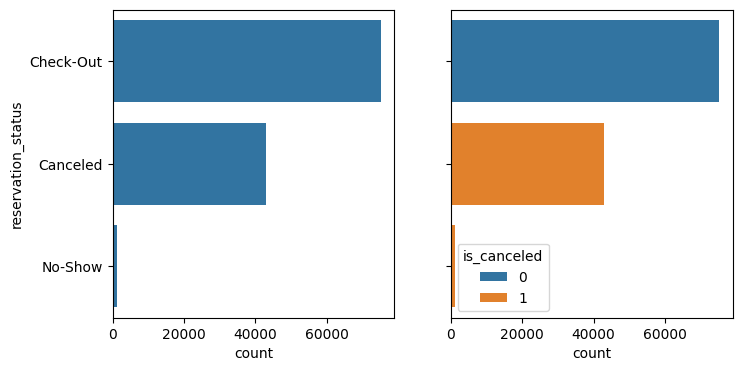

In [25]:
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(8, 4))
sns.countplot(df, y="reservation_status",ax=ax1)
sns.countplot(df, y="reservation_status", hue="is_canceled", ax=ax2)

In [26]:
df = df.drop(columns=["reservation_status", "reservation_status_date"])

## Análise de correlação

Nenhuma das variáveis numericas possuem uma alta correlação, logo todas serão mantidas.

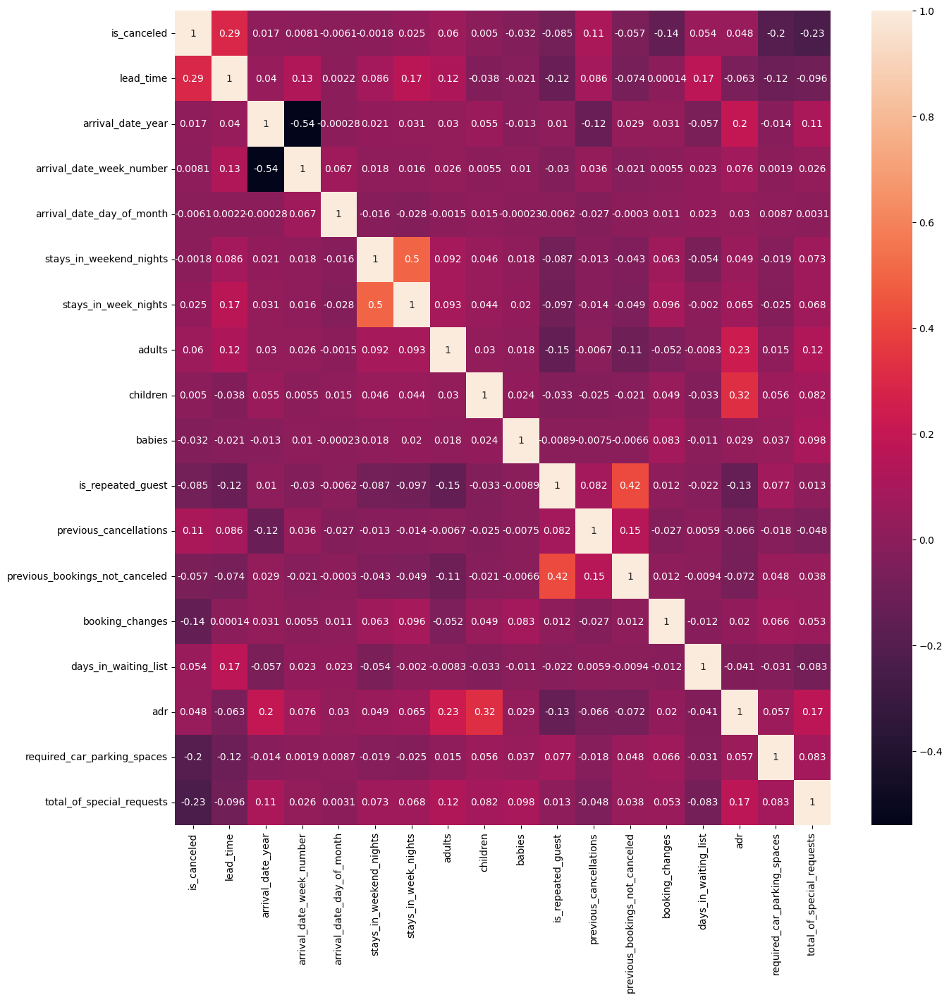

In [27]:
plt.figure(figsize=(15, 15))
dataplot = sns.heatmap(df.select_dtypes(exclude=['object']).corr(), annot=True)
plt.show()

# Tratando variáveis

## Categóricas

Para as variáveis categorias será realizado o One Hot Encoding

In [28]:
dist_channel = pd.get_dummies(df["distribution_channel"], prefix="dist_channel", drop_first= False)
df = pd.concat([df, dist_channel], axis= 1)
df = df.drop(columns=["distribution_channel"])

In [29]:
hotel = pd.get_dummies(df["hotel"], prefix="hotel", drop_first= False)
df = pd.concat([df, hotel], axis= 1)
df = df.drop(columns=["hotel"])

In [30]:
customer_type = pd.get_dummies(df["customer_type"], prefix="customer_type", drop_first= False)
df = pd.concat([df, customer_type], axis= 1)
df = df.drop(columns=["customer_type"])

In [31]:
meal = pd.get_dummies(df["meal"], prefix="meal", drop_first= False)
df = pd.concat([df, meal], axis= 1)
df = df.drop(columns=["meal"])

In [32]:
market_segment = pd.get_dummies(df["market_segment"], prefix="market_segment", drop_first= False)
df = pd.concat([df, market_segment], axis= 1)
df = df.drop(columns=["market_segment"])

In [33]:
reserved_room_type = pd.get_dummies(df["reserved_room_type"], prefix="reserved_room_type", drop_first= False)
df = pd.concat([df, reserved_room_type], axis= 1)
df = df.drop(columns=["reserved_room_type"])

In [34]:
assigned_room_type = pd.get_dummies(df["assigned_room_type"], prefix="assigned_room_type", drop_first= False)
df = pd.concat([df, assigned_room_type], axis= 1)
df = df.drop(columns=["assigned_room_type"])

In [35]:
deposit_type = pd.get_dummies(df["deposit_type"], prefix="deposit_type", drop_first= False)
df = pd.concat([df, deposit_type], axis= 1)
df = df.drop(columns=["deposit_type"])

In [36]:
df

,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,...,assigned_room_type_F,assigned_room_type_G,assigned_room_type_H,assigned_room_type_I,assigned_room_type_K,assigned_room_type_L,assigned_room_type_P,deposit_type_No Deposit,deposit_type_Non Refund,deposit_type_Refundable
0,0,342,2015,July,27,1,0,0,2,0,...,0,0,0,0,0,0,0,1,0,0
1,0,737,2015,July,27,1,0,0,2,0,...,0,0,0,0,0,0,0,1,0,0
2,0,7,2015,July,27,1,0,1,1,0,...,0,0,0,0,0,0,0,1,0,0
3,0,13,2015,July,27,1,0,1,1,0,...,0,0,0,0,0,0,0,1,0,0
4,0,14,2015,July,27,1,0,2,2,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119385,0,23,2017,August,35,30,2,5,2,0,...,0,0,0,0,0,0,0,1,0,0
119386,0,102,2017,August,35,31,2,5,3,0,...,0,0,0,0,0,0,0,1,0,0
119387,0,34,2017,August,35,31,2,5,2,0,...,0,0,0,0,0,0,0,1,0,0
119388,0,109,2017,August,35,31,2,5,2,0,...,0,0,0,0,0,0,0,1,0,0


## Data

O ano será removido para deixar os dados mais genericos e a "arrival_date_month" pois a informação de tempo ao longo do ano já está contidada na variável "arrival_date_week_number"

In [37]:
df = df.drop(columns=["arrival_date_year", "arrival_date_month"])

# Treinando os modelos

Serão utilizados 3 algoritmos baseados em conjunto de àrvores, Random Forest, XGBoost e o LightGM, desta forma será possivel comparar e analisar como cada um realiza a predição da base de dados.

## Separando entre treino e teste

In [38]:
y = df["is_canceled"]
X = df.drop(columns="is_canceled")

In [39]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

## Treinando e avaliando Random Forest

In [40]:
from sklearn.ensemble import RandomForestClassifier

rf_model = RandomForestClassifier(random_state=42, n_jobs=-1)

rf_model.fit(X_train, y_train)

RandomForestClassifier(n_jobs=-1, random_state=42)

In [41]:
Y_pred_rf = rf_model.predict(X_test)

In [42]:
from sklearn.metrics import classification_report

print(classification_report(y_test, Y_pred_rf))

              precision    recall  f1-score   support

           0       0.87      0.93      0.90     24738
           1       0.86      0.76      0.80     14660

    accuracy                           0.86     39398
   macro avg       0.86      0.84      0.85     39398
weighted avg       0.86      0.86      0.86     39398



In [43]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

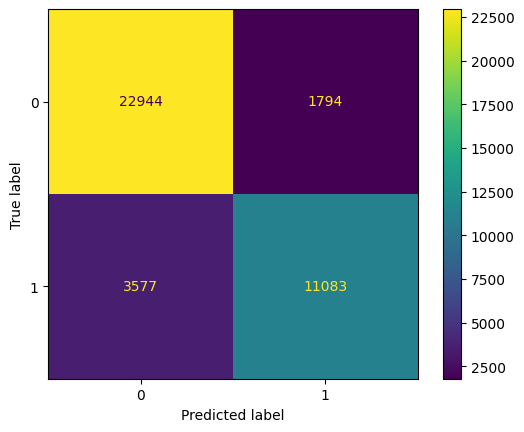

In [44]:
cm = confusion_matrix(y_test, Y_pred_rf, labels=rf_model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rf_model.classes_)
disp.plot()

## Treinando e avaliando XGboost

In [45]:
from xgboost import XGBClassifier

xgb_model = XGBClassifier(n_jobs=-1, random_state=42)
xgb_model.fit(X_train, y_train)
Y_pred_xgb = xgb_model.predict(X_test)

In [46]:
print(classification_report(y_test, Y_pred_xgb))

              precision    recall  f1-score   support

           0       0.84      0.93      0.88     24738
           1       0.85      0.71      0.77     14660

    accuracy                           0.84     39398
   macro avg       0.85      0.82      0.83     39398
weighted avg       0.84      0.84      0.84     39398



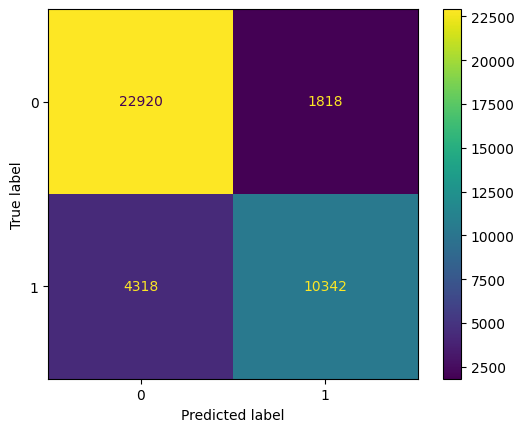

In [47]:
cm = confusion_matrix(y_test, Y_pred_xgb, labels=xgb_model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=xgb_model.classes_)
disp.plot(values_format='')

## Treinando e avaliando LightGBM

In [48]:
import lightgbm as lgb

lgb_model = lgb.LGBMClassifier(n_jobs=-1)

lgb_model.fit(X_train, y_train)
Y_pred_lgb = lgb_model.predict(X_test)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 29560, number of negative: 50428
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.681919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 920
[LightGBM] [Info] Number of data points in the train set: 79988, number of used features: 59
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.369555 -> initscore=-0.534124
[LightGBM] [Info] Start training from score -0.534124


In [49]:
Y_pred_lgb = lgb_model.predict(X_test)

In [50]:
print(classification_report(y_test, Y_pred_lgb))

              precision    recall  f1-score   support

           0       0.83      0.93      0.88     24738
           1       0.86      0.68      0.76     14660

    accuracy                           0.84     39398
   macro avg       0.84      0.81      0.82     39398
weighted avg       0.84      0.84      0.83     39398



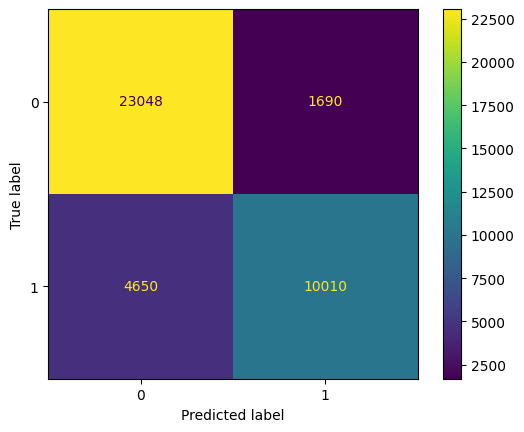

In [51]:
cm = confusion_matrix(y_test, Y_pred_lgb, labels=lgb_model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=lgb_model.classes_)
disp.plot(values_format='')

# Analisando curva ROC de todos os modelos

<Figure size 640x480 with 0 Axes>

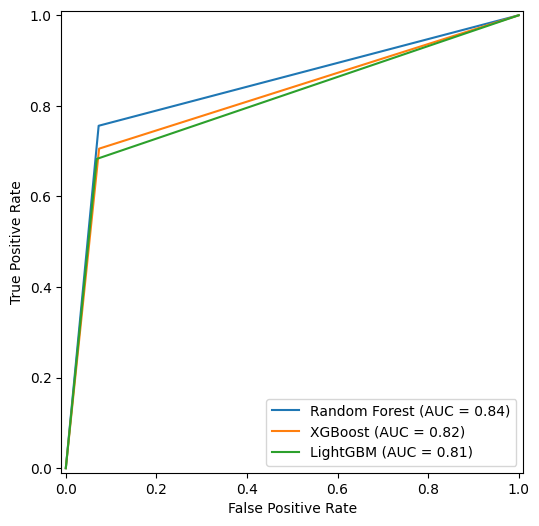

In [52]:
from sklearn.metrics import RocCurveDisplay, auc, roc_curve

plt.clf()

fpr, tpr, thresholds = roc_curve(y_test, Y_pred_rf)
roc_auc = auc(fpr, tpr)
display_rf = RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name = "Random Forest")


fpr, tpr, thresholds = roc_curve(y_test, Y_pred_xgb)
roc_auc = auc(fpr, tpr)
display_lr = RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name = "XGBoost")


fpr, tpr, thresholds = roc_curve(y_test, Y_pred_lgb)
roc_auc = auc(fpr, tpr)
display_nb = RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name = "LightGBM")


plt.figure(figsize=(10,6))

ax = plt.gca()

display_rf.plot(ax=ax)

display_lr.plot(ax=ax)

display_nb.plot(ax=ax)

plt.show()

## Conclusão acerca dos resultados 

O Random Forest foi o modelo que obteve a maior área sob a curva (0,84 contra 0,82 do XGBoost e 0,81 do LightGBM), além da maior acurácia (0.86 contra 0.84 dos demais) e o melhor recall (0.76 contra 0.71 do XGBoost e 0.68 do LightGM), sendo assim o que obteve o melhor resultado, enquanto o LightGM obteve  pior.

# Interpretabilidade

## Global Surrogate

Será criado um modelo Global Surrogate para cada um dos modelos treinados anteriormente.

### Random Forest

In [53]:
from sklearn.tree import DecisionTreeClassifier

dtree_rf = DecisionTreeClassifier(criterion = 'entropy', max_depth = 3, min_samples_leaf = 30)

dtree_rf.fit(X_test, Y_pred_rf)

Y_pred_dtree_rf = dtree_rf.predict(X_test)

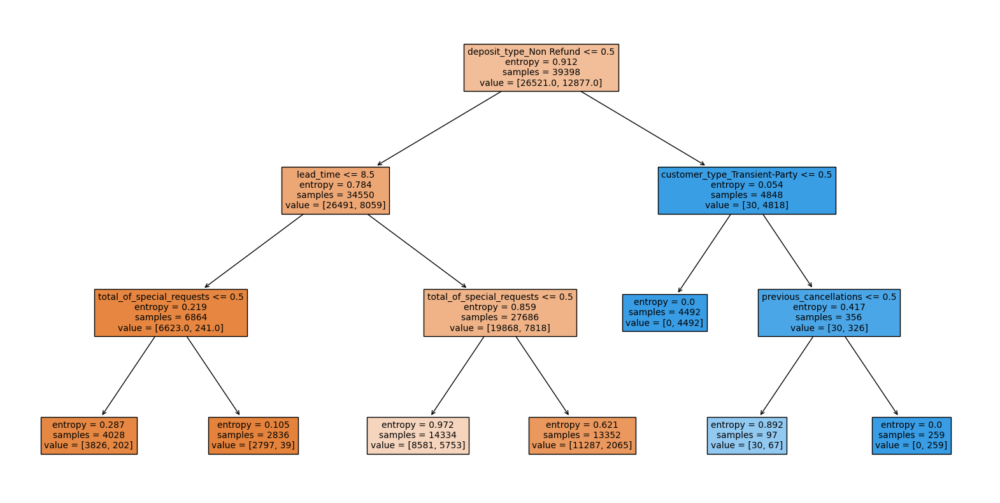

In [54]:
from sklearn import tree

plt.figure(figsize=(20,10))


tree.plot_tree(dtree_rf, feature_names = X.columns,filled = True, fontsize=10);

### Xgboost

In [55]:
dtree_xgb = DecisionTreeClassifier(criterion = 'entropy', max_depth = 3, min_samples_leaf = 30)

dtree_xgb.fit(X_test, Y_pred_xgb)

Y_pred_dtree_xgb = dtree_xgb.predict(X_test)

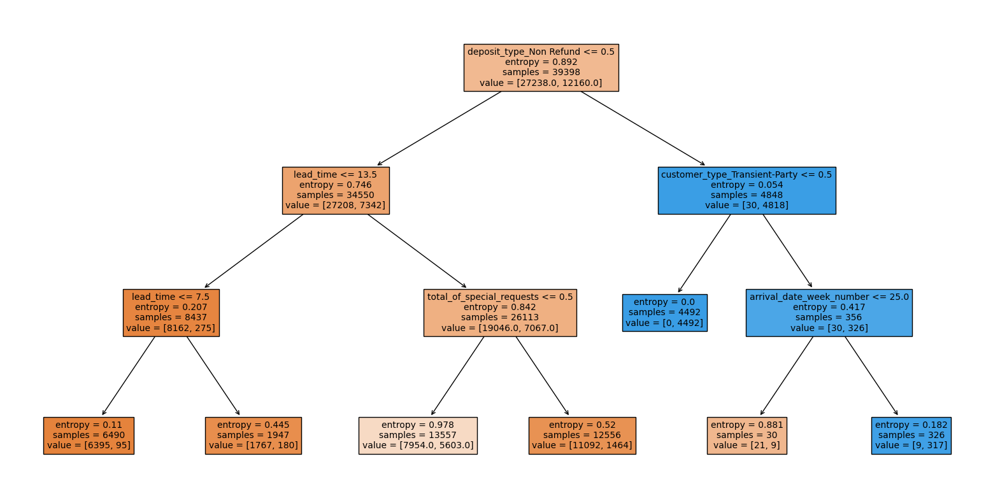

In [56]:
from sklearn import tree

plt.figure(figsize=(20,10))

tree.plot_tree(dtree_xgb, feature_names = X.columns,filled = True, fontsize=10);

### LightGBM

In [57]:
dtree_lgb = DecisionTreeClassifier(criterion = 'entropy', max_depth = 3, min_samples_leaf = 30)

dtree_lgb.fit(X_test, Y_pred_lgb)

Y_pred_dtree_lgb = dtree_lgb.predict(X_test)

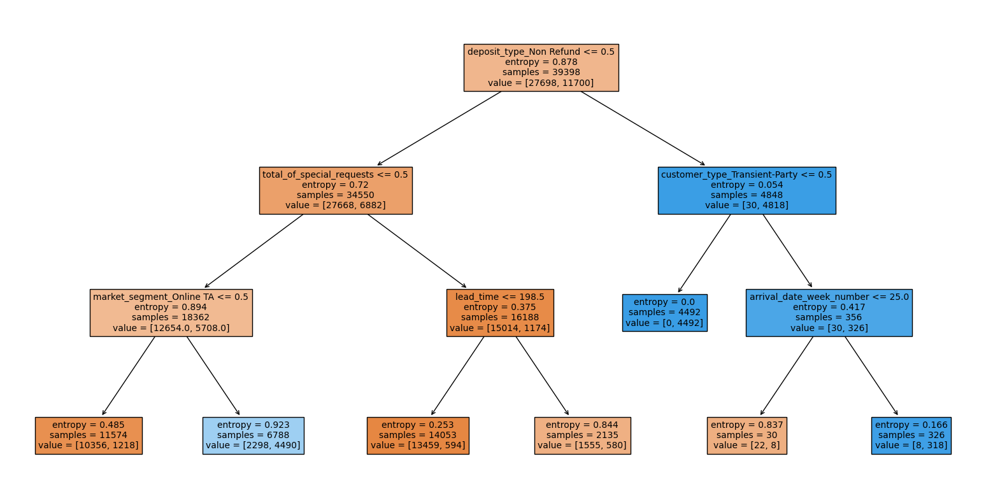

In [58]:
from sklearn import tree

plt.figure(figsize=(20,10))

tree.plot_tree(dtree_lgb, feature_names = X.columns,filled = True, fontsize=10);

### Comentarios acerca dos modelos Global Surrogate

Nos três modelos a variável "deposit_type_Non Refund" foi selecionada como raiz, como verificado durante a análise das variáveis categoricas, 99% dos clientes que realizam o deposito do valor completo realizaram o cancelamento, o que pode ter influenciado os modelos a selecionaram essa variável para realizar a primeira separação.

As variáveis selecionadas no primeiro nível também são as mesmas nos modelos Random Forest e XGBoost, já no LighGBM foi selecionada a varável "total_of_special_requests" ao invéz da "lead_time". 

Para a variável "total_of_special_requests" analisar se a quantidade de pedidos especiais é maior que 0 é um bom indicativo se foi realizado um cancelamento ou não, visto que o ponto de corte 0.5 é utilizado no primeiro nível nos Global Surrogate do LightGBM e no segundo nível para o Random Forest e XGBoost. Um ponto a ser observado no segundo nível é a  entropia próxima a zero no nó que realiza a separação pela variável "customer_type_Transient-Party". Para clientes que realizaram o deposito do valor total e o customer_type não é "Transient-Party" os modelos Global Surrogates predizem um cancelamento.

No segundo nível existem algumas diferenças entre os modelos, enquanto o "lead_time" é utilizado no Global Surrogate do Random Forest e XGBoost no primeiro nível, no LightGBM é utilizado no segundo nível e com diferentes pontos de corte, o que pode indicar que não exista uma divisão bem definida para se considerar um cancelamento utilizando esta variável, ao contrario do que acontece com a "total_of_special_requests".

A variável "previous_cancellations" que informa a quantidade de cancelamentos anteriores, foi utilizada apenas pelo Global Surrogate do Random Forest o que pode indicar uma menor importância dada a essa variável pelo XGBoost e LightGBM.

## Analisando a importância das variáveis com Permutation Feature Importance (PFI)

A base de testes será dividade por classe, desta forma será analisada a importância das variáveis pada cada classe.

In [59]:
temp_df = X_test.copy()

In [60]:
temp_df["label"] = y_test

In [61]:
X_test_1 = temp_df[temp_df["label"] == 1].copy()
X_test_0 = temp_df[temp_df["label"] == 0].copy()

In [62]:
Y_test_1 = X_test_1["label"]
X_test_1 = X_test_1.drop(columns = ["label"])

In [63]:
Y_test_0 = X_test_0["label"]
X_test_0 = X_test_0.drop(columns = ["label"])

### Classe positiva (cancelou a reserva)

Devido a quantidade de variáveis, serão exibidas no gráfico apenas as 15 varáveis com a maior diminuição da acurácia para cada modelo.

In [64]:
from sklearn.inspection import permutation_importance

In [65]:
rf_result_1 = permutation_importance(rf_model, X_test_1, Y_test_1, n_repeats=10, random_state=42, n_jobs= -1)

rf_importances_1 = pd.DataFrame(rf_result_1.importances_mean, index=X_test_1.columns, columns=["decrease_ac"])
rf_importances_1["std"] = rf_result_1.importances_std

rf_importances_1 = rf_importances_1.sort_values(by = ["decrease_ac"])
rf_importances_top_1 = rf_importances_1.tail(15)

In [66]:
rf_importances_top_1

,decrease_ac,std
hotel_City Hotel,0.017326,0.000748
stays_in_week_nights,0.018827,0.001278
arrival_date_day_of_month,0.020280,0.001530
reserved_room_type_D,0.022060,0.000829
lead_time,0.022906,0.001771
market_segment_Offline TA/TO,0.024420,0.000659
market_segment_Groups,0.025634,0.001314
customer_type_Transient-Party,0.028636,0.000815
arrival_date_week_number,0.034345,0.001248
assigned_room_type_D,0.043874,0.001078


In [67]:
xgb_result_1 = permutation_importance(xgb_model, X_test_1, Y_test_1, n_repeats=10, random_state=42, n_jobs= -1)

xgb_importances_1 = pd.DataFrame(xgb_result_1.importances_mean, index=X_test_1.columns, columns=["decrease_ac"])
xgb_importances_1["std"] = xgb_result_1.importances_std

xgb_importances_1 = xgb_importances_1.sort_values(by = ["decrease_ac"])
xgb_importances_top_1 = xgb_importances_1.tail(15)

In [68]:
xgb_importances_top_1

,decrease_ac,std
assigned_room_type_F,0.008411,0.000461
arrival_date_day_of_month,0.008492,0.000776
reserved_room_type_E,0.009611,0.000252
reserved_room_type_F,0.009611,0.000331
assigned_room_type_E,0.009898,0.000379
meal_SC,0.009905,0.000770
arrival_date_week_number,0.010914,0.001246
market_segment_Groups,0.013533,0.000737
hotel_City Hotel,0.015055,0.001436
customer_type_Transient-Party,0.019925,0.000612


In [69]:
lgb_result_1 = permutation_importance(lgb_model, X_test_1, Y_test_1, n_repeats=10, random_state=42, n_jobs= -1)

lgb_importances_1 = pd.DataFrame(lgb_result_1.importances_mean, index=X_test_1.columns, columns=["decrease_ac"])
lgb_importances_1["std"] = lgb_result_1.importances_std

lgb_importances_1 = lgb_importances_1.sort_values(by = ["decrease_ac"])
lgb_importances_top_1 = lgb_importances_1.tail(15)

In [70]:
lgb_importances_top_1

,decrease_ac,std
meal_SC,0.004693,0.000299
arrival_date_week_number,0.006562,0.000791
reserved_room_type_F,0.006671,0.000378
assigned_room_type_F,0.007094,0.000494
arrival_date_day_of_month,0.009127,0.000724
market_segment_Groups,0.012974,0.000552
market_segment_Offline TA/TO,0.013111,0.000798
hotel_City Hotel,0.014625,0.001479
customer_type_Transient-Party,0.028472,0.000808
deposit_type_Non Refund,0.034120,0.002239


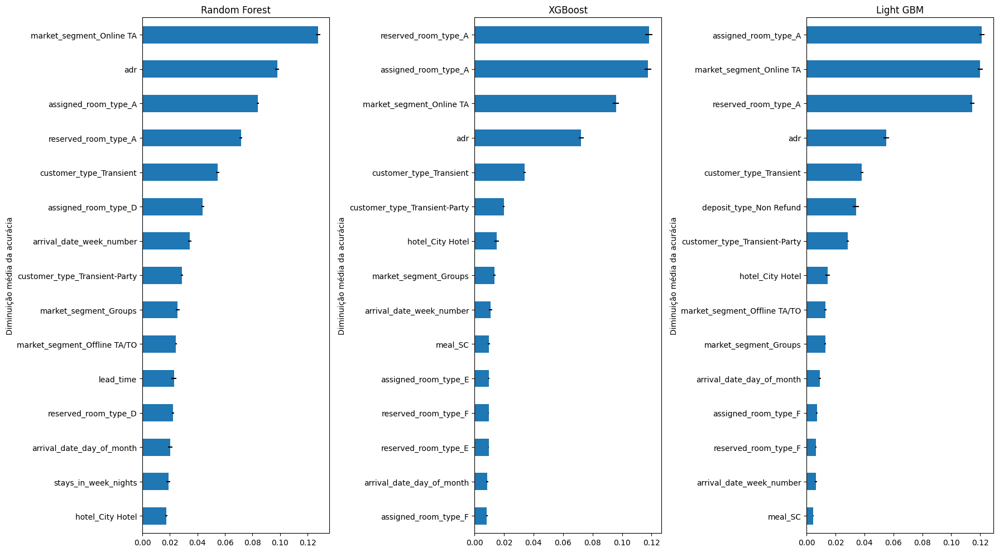

In [71]:
fig, axs = plt.subplots(ncols=3, figsize=(18,10), dpi=100)

rf_importances_top_1["decrease_ac"].plot.barh(ax=axs[0], xerr=rf_importances_top_1["std"].values)
axs[0].set_title("Random Forest")
axs[0].set_ylabel("Diminuição média da acurácia")

xgb_importances_top_1["decrease_ac"].plot.barh(ax=axs[1], xerr=xgb_importances_top_1["std"].values)
axs[1].set_title("XGBoost")
axs[1].set_ylabel("Diminuição média da acurácia")

lgb_importances_top_1["decrease_ac"].plot.barh(ax=axs[2], xerr=lgb_importances_top_1["std"].values)
axs[2].set_title("Light GBM")
axs[2].set_ylabel("Diminuição média da acurácia")

fig.tight_layout()
plt.show()

As cinco variáveis com a maior diminuição média da acurácia foram as mesmas para os três modelos, porem em diferentes ordens, a variável "market_segment_Online TA" obteve uma diminuiçao de 0,127 no Random Forest, sendo a variável mais importante para o modelo de acordo com o PFI, enquanto no XGBoost obteve 0,095, ficando em terceiro lugar e 0,12 no LightGBM ficando em segundo lugar.

Observa-se que as variáveis assigned_room_type_A e reserved_room_type_A obtiveram uma grande diminuição em todos os modelos, o que pode indicar uma relação entre os quartos do tipo A e o cancelamento. Como o PFI gera registros que não são válidos na vida real devido a permutação, como por exemplo a reserva de dois tipos de quartos diferentes ao mesmo tempo, é necessario realizar mais analises utilizando outros métodos.

Outra variável que obteve uma diminuição consideravel foi a "adr" (tarifa média diaria) com 0,097 no Random Forest, 0,072 no XGBoost e 0,055 no LightGBM.

### Classe negativa (não cancelou a reserva)

In [72]:
rf_result = permutation_importance(rf_model, X_test_0, Y_test_0, n_repeats=10, random_state=42, n_jobs= -1)

rf_importances = pd.DataFrame(rf_result.importances_mean, index=X_test_0.columns, columns=["decrease_ac"])
rf_importances["std"] = rf_result.importances_std

rf_importances = rf_importances.sort_values(by = ["decrease_ac"])
rf_importances_top = rf_importances.tail(15)

In [73]:
rf_importances_top

,decrease_ac,std
market_segment_Aviation,0.000004,0.000012
deposit_type_Refundable,0.000024,0.000027
dist_channel_GDS,0.000036,0.000012
reserved_room_type_H,0.000040,0.000040
assigned_room_type_H,0.000085,0.000038
meal_FB,0.000097,0.000032
deposit_type_Non Refund,0.000222,0.000058
deposit_type_No Deposit,0.000449,0.000132
required_car_parking_spaces,0.000623,0.000345
stays_in_week_nights,0.000687,0.000742


In [74]:
xgb_result = permutation_importance(xgb_model, X_test_0, Y_test_0, n_repeats=10, random_state=42, n_jobs= -1)

xgb_importances = pd.DataFrame(xgb_result.importances_mean, index=X_test_0.columns, columns=["decrease_ac"])
xgb_importances["std"] = xgb_result.importances_std

xgb_importances = xgb_importances.sort_values(by = ["decrease_ac"])
xgb_importances_top = xgb_importances.tail(15)

In [75]:
xgb_importances_top

,decrease_ac,std
market_segment_Corporate,0.000711,0.000209
dist_channel_TA/TO,0.000776,0.000150
meal_FB,0.000833,0.000175
deposit_type_Non Refund,0.000942,0.000072
stays_in_weekend_nights,0.001132,0.000393
arrival_date_day_of_month,0.001330,0.000470
required_car_parking_spaces,0.001447,0.000403
adults,0.001710,0.000570
previous_cancellations,0.005000,0.000191
dist_channel_Corporate,0.005279,0.000246


In [76]:
lgb_result = permutation_importance(lgb_model, X_test_0, Y_test_0, n_repeats=10, random_state=42, n_jobs= -1)

lgb_importances = pd.DataFrame(lgb_result.importances_mean, index=X_test_0.columns, columns=["decrease_ac"])
lgb_importances["std"] = lgb_result.importances_std

lgb_importances = lgb_importances.sort_values(by = ["decrease_ac"])
lgb_importances_top = lgb_importances.tail(15)

In [77]:
lgb_importances_top

,decrease_ac,std
required_car_parking_spaces,0.000388,0.000377
meal_Undefined,0.000424,0.000058
adults,0.000590,0.000269
dist_channel_TA/TO,0.000877,0.000124
deposit_type_Non Refund,0.000942,0.000063
market_segment_Corporate,0.000950,0.000122
stays_in_weekend_nights,0.001027,0.000346
previous_bookings_not_canceled,0.001706,0.000249
dist_channel_Corporate,0.002090,0.000134
stays_in_week_nights,0.003028,0.000344


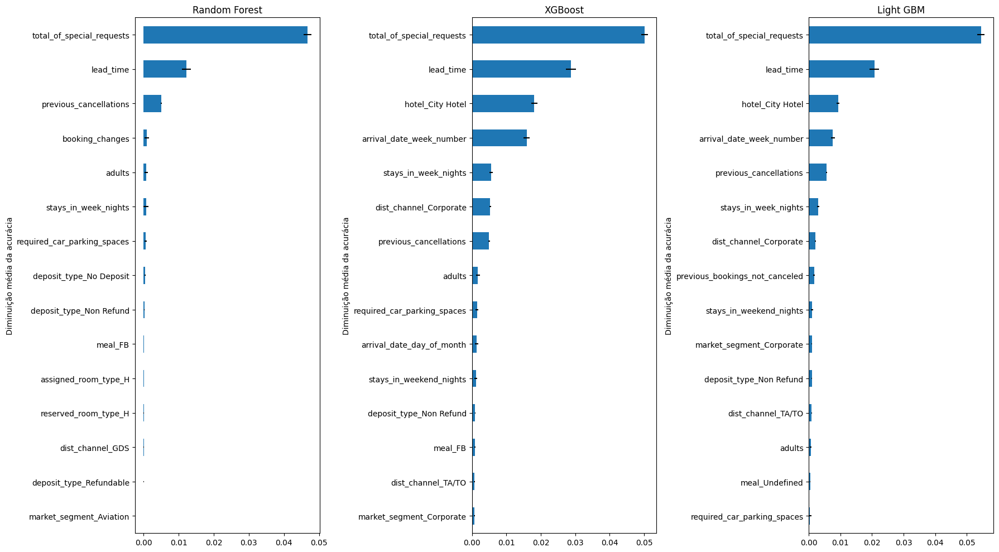

In [78]:
fig, axs = plt.subplots(ncols=3, figsize=(18,10), dpi=100)

rf_importances_top["decrease_ac"].plot.barh(ax=axs[0], xerr=rf_importances_top["std"].values)
axs[0].set_title("Random Forest")
axs[0].set_ylabel("Diminuição média da acurácia")

xgb_importances_top["decrease_ac"].plot.barh(ax=axs[1], xerr=xgb_importances_top["std"].values)
axs[1].set_title("XGBoost")
axs[1].set_ylabel("Diminuição média da acurácia")

lgb_importances_top["decrease_ac"].plot.barh(ax=axs[2], xerr=lgb_importances_top["std"].values)
axs[2].set_title("Light GBM")
axs[2].set_ylabel("Diminuição média da acurácia")

fig.tight_layout()
plt.show()

Para a clase negativa, observa-se uma menor diminuição média da acurácia pelas variáveis quando comparado com a classe positiva, a variável com a menor diminuição nos três modelos, "total_of_special_requests", obteve uma diminuição em torno de 0,054 enquanto a com a menor diminuição para a classe positiva chegou a 0,127.

No Random Forest verifica-se que apenas três variáveis obtiveram uma diminuição, "total_of_special_requests", "lead_time" e "previous_cancellations". Estas três variáveis também foram utilizadas pelo Global Surrogate deste modelo, o que confirma a importância delas para o modelo. 

A variável "total_of_special_requests" é a mais importante para a classe 0 para todos os modelos de acordo com o PFI, seguida pela "lead_time".

## Partial dependency Plot

In [80]:
from sklearn.inspection import PartialDependenceDisplay

### Analisando as variáveis que obtiveram maior importância para a classe positiva

#### assigned_room_type_A

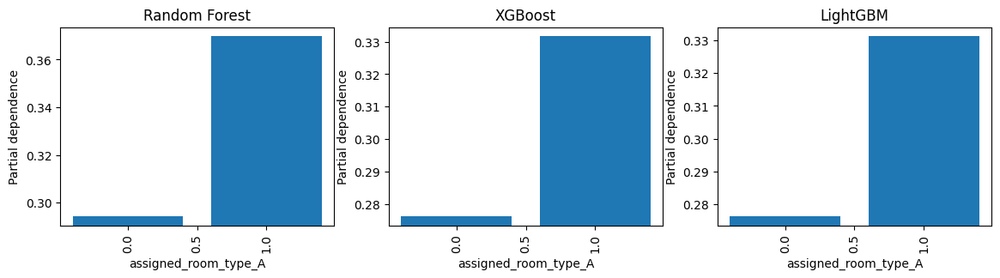

In [81]:
fig, axs = plt.subplots(ncols=3, figsize=(14,3))

axs[0].set_title("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["assigned_room_type_A"], n_jobs = -1, categorical_features =  ["assigned_room_type_A"], ax=axs[0])

axs[1].set_title("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["assigned_room_type_A"], n_jobs = -1, categorical_features =  ["assigned_room_type_A"], ax=axs[1])

axs[2].set_title("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["assigned_room_type_A"], n_jobs = -1, categorical_features =  ["assigned_room_type_A"], ax=axs[2])

Para os três modelos, clientes que foram atribuidos ao quarto A possuem uma maior probabilidade de cancelamento.

#### reserved_room_type_A

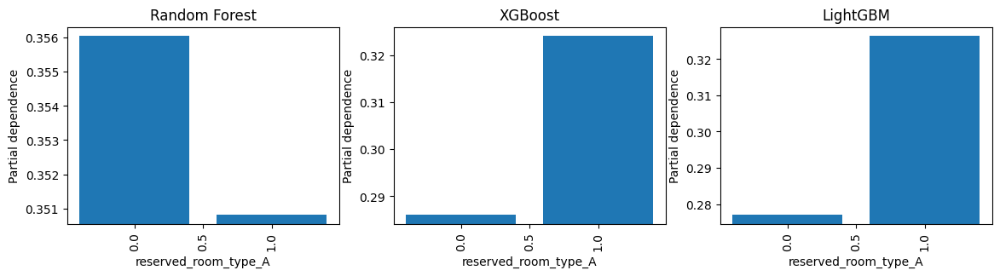

In [82]:
fig, axs = plt.subplots(ncols=3, figsize=(14,3))

axs[0].set_title("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["reserved_room_type_A"], n_jobs = -1, categorical_features =  ["reserved_room_type_A"], ax=axs[0])

axs[1].set_title("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["reserved_room_type_A"], n_jobs = -1, categorical_features =  ["reserved_room_type_A"], ax=axs[1])

axs[2].set_title("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["reserved_room_type_A"], n_jobs = -1, categorical_features =  ["reserved_room_type_A"], ax=axs[2])

Para o XGBoost e o LightGBM, clientes que reservaram o quarto do tipo A possuem uma maior probabilidade de cancelamento, entretanto para o Random Forest é observado o contrario, clientes que reservaram o quarto do tipo A possuem uma menor probabiliade, porem, como o valores somente alteram na terceira casa decimal, podemos concluir que, no Random Forest, o efeito dessa variável na probabilidade de cancelamento é baixo. 

#### market_segment_Online TA

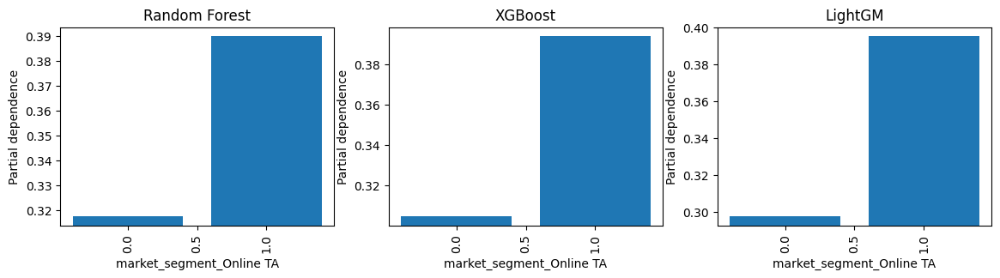

In [83]:
fig, axs = plt.subplots(ncols=3, figsize=(14,3))

axs[0].set_title("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["market_segment_Online TA"], n_jobs = -1, categorical_features =  ["market_segment_Online TA"], ax=axs[0])

axs[1].set_title("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["market_segment_Online TA"], n_jobs = -1, categorical_features =  ["market_segment_Online TA"], ax=axs[1])

axs[2].set_title("LightGM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["market_segment_Online TA"], n_jobs = -1, categorical_features =  ["market_segment_Online TA"], ax=axs[2])

Para os clientes de agencias turisticas Online os modelos atribuem uma maior probabilidade de cancelamento.

#### adr

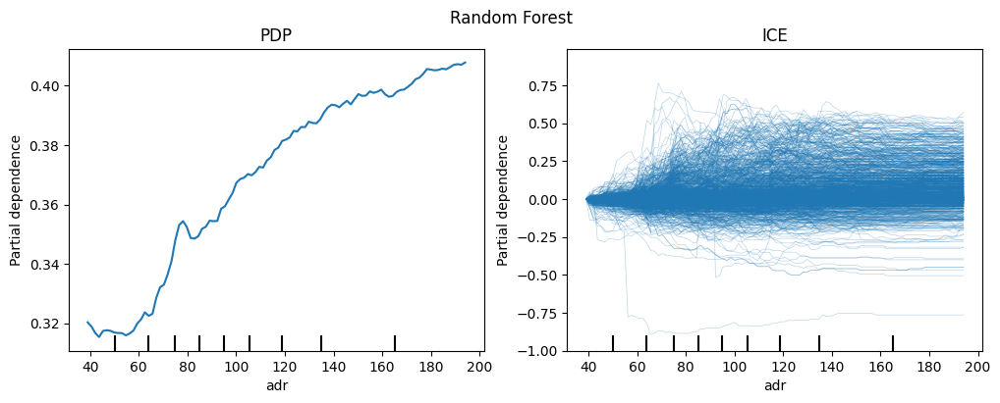

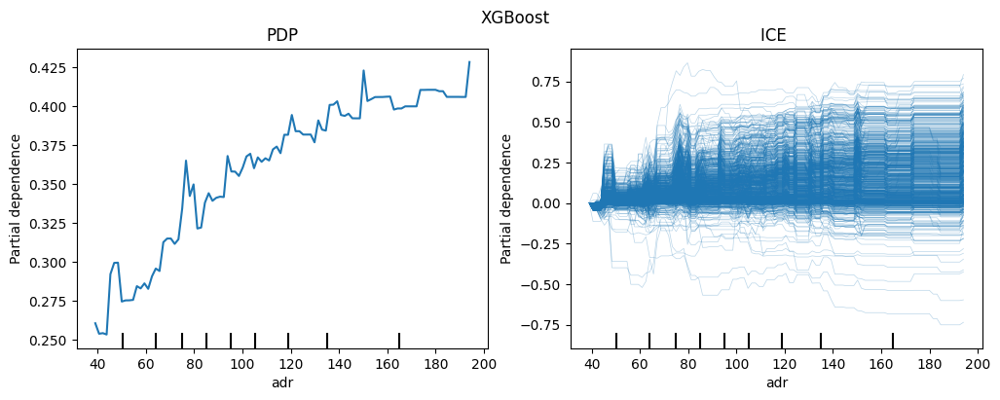

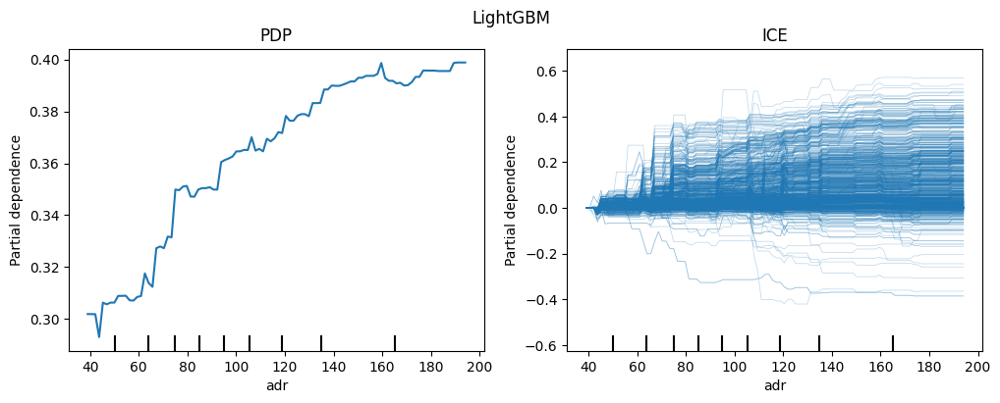

In [84]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("Random Forest")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["adr"], ax = axs[0], n_jobs = -1)
axs[1].set_title("ICE")
disp2 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["adr"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("XGBoost")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["adr"], ax = axs[0], n_jobs = -1)
axs[1].set_title("ICE ")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["adr"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("LightGBM")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["adr"], ax = axs[0], n_jobs = -1)
axs[1].set_title("ICE")
disp2 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["adr"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)


De forma geral quanto maior a tarifa média diaria, maior a probabilidade de cancelamento atribuida pelos modelos, entretanto é possivel observar que isso não é valido para todas as instâncias ao analisar o ICE, onde algumas instâncias possuem uma redução da probabilidade quando o valor é aumentado.

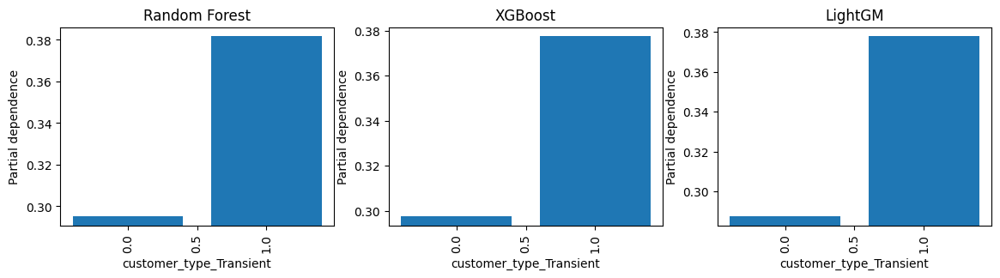

In [85]:
fig, axs = plt.subplots(ncols=3, figsize=(14,3))

axs[0].set_title("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["customer_type_Transient"], n_jobs = -1, categorical_features =  ["customer_type_Transient"], ax=axs[0])

axs[1].set_title("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["customer_type_Transient"], n_jobs = -1, categorical_features =  ["customer_type_Transient"], ax=axs[1])

axs[2].set_title("LightGM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["customer_type_Transient"], n_jobs = -1, categorical_features =  ["customer_type_Transient"], ax=axs[2])

Os modelos atribuem uma maior probabilidade de cancelamento quando o "customer_type" é "transient", ou seja, o agendamento não é associado a um grupo ou contrato.

#### previous_cancellations

A variável "previous_cancellations" também foi analisada por ser a terceira mais importante para o Random Forest e ser utilizado pela Global Surrogate deste modelo. 

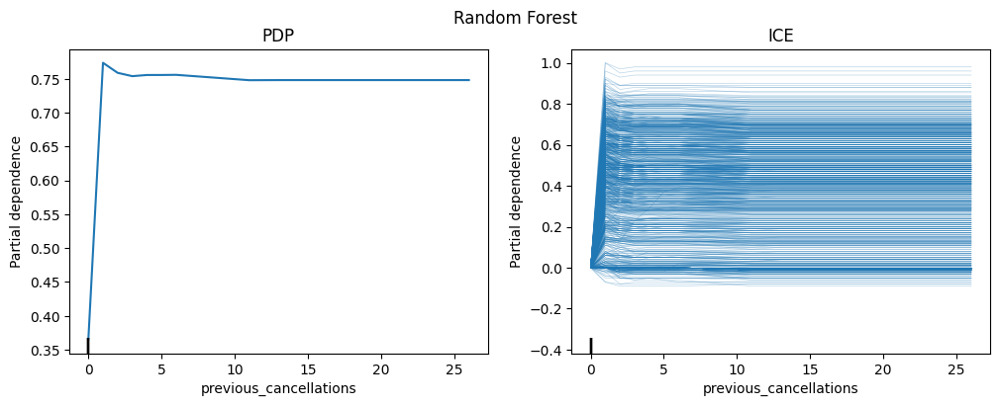

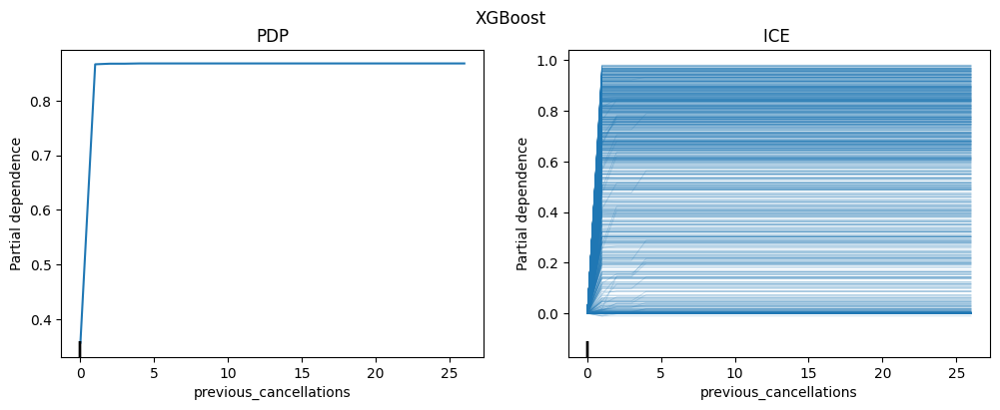

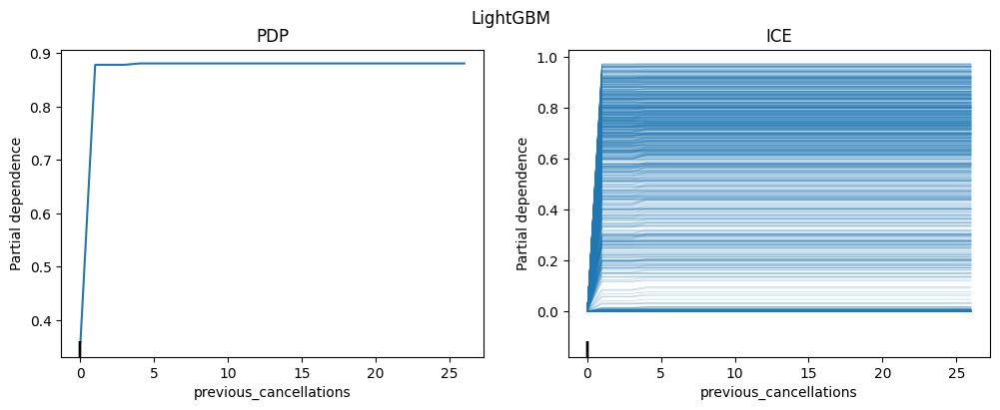

In [129]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("Random Forest")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["previous_cancellations"], ax = axs[0], n_jobs = -1)
axs[1].set_title("ICE")
disp2 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["previous_cancellations"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("XGBoost")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["previous_cancellations"], ax = axs[0], n_jobs = -1)
axs[1].set_title("ICE ")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["previous_cancellations"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("LightGBM")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["previous_cancellations"], ax = axs[0], n_jobs = -1)
axs[1].set_title("ICE")
disp2 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["previous_cancellations"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)


Nos três modelos existe uma grande diferença nas probabilidade quando o valor é 0, embora no Random Forest esta diferença seja um pouco menor, outro aspecto notado é que a quantidade de cancelamentos maiores do que 1 não influência significamente na probabilidade.

#### deposit_type_Non Refund

A variável "deposit_type_Non Refund" foi utilizada como raiz pelos modelos Global Surrogate e obteve uma redução de 0.04 no valor média da acurácia para o LightGBM, desta forma também foi escolhida para ser analisada. 

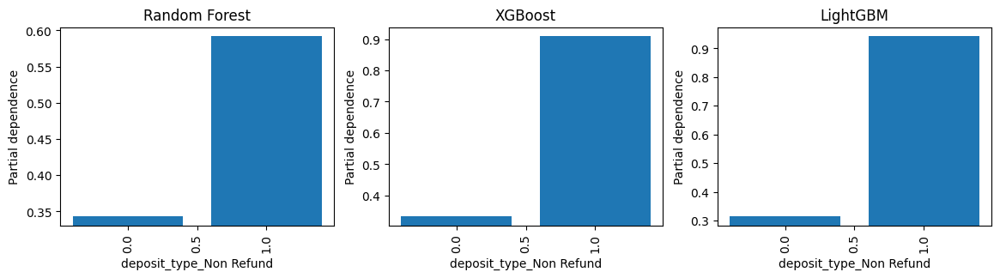

In [227]:
fig, axs = plt.subplots(ncols=3, figsize=(14,3))

axs[0].set_title("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["deposit_type_Non Refund"], n_jobs = -1, categorical_features =  ["deposit_type_Non Refund"], ax=axs[0])

axs[1].set_title("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["deposit_type_Non Refund"], n_jobs = -1, categorical_features =  ["deposit_type_Non Refund"], ax=axs[1])

axs[2].set_title("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["deposit_type_Non Refund"], n_jobs = -1, categorical_features =  ["deposit_type_Non Refund"], ax=axs[2])

Verifica-se que os três modelos atribuem um grande aumento na probabilidade quando o valor é 1, esse aumento é ainda maior no modelo LightGBM.

### Analisando as variáveis que obtiveram maior importância para a classe negativa

#### total_of_special_requests

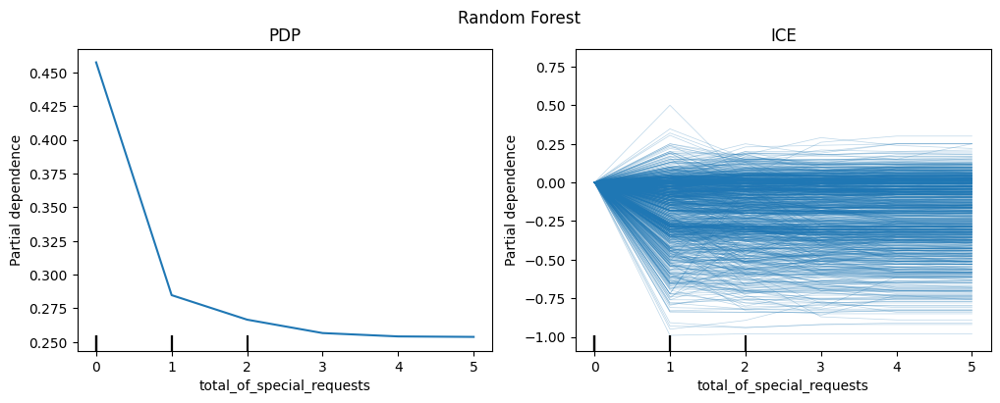

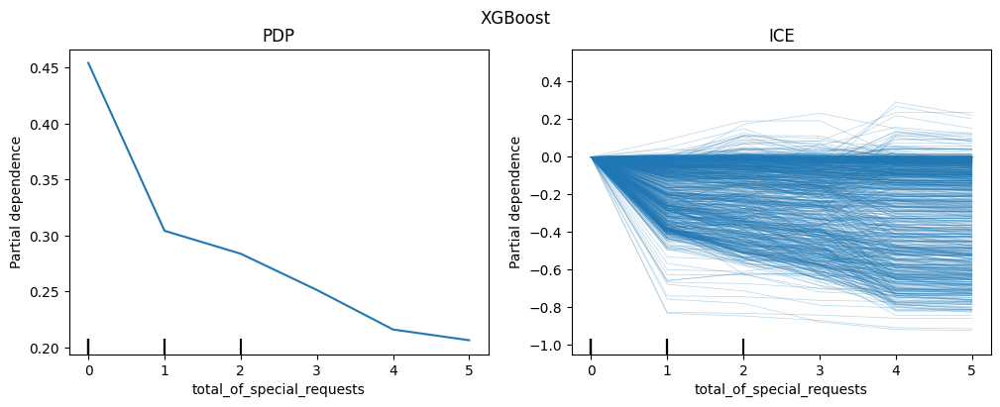

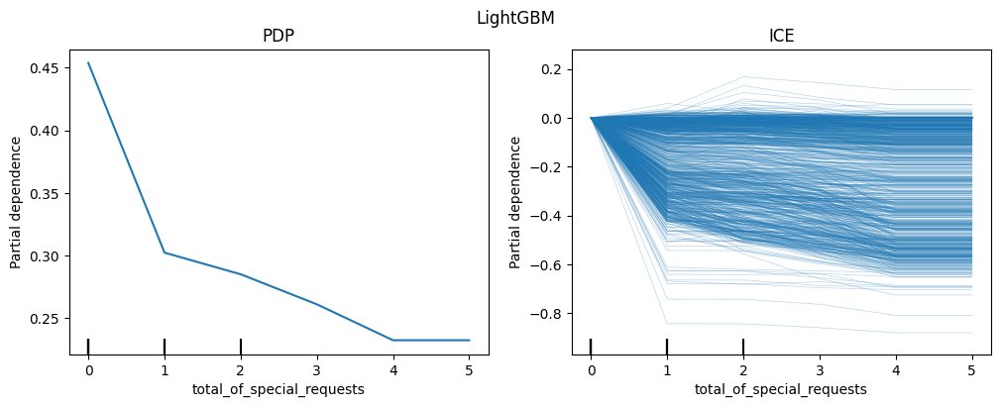

In [228]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("Random Forest")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["total_of_special_requests"], ax = axs[0], n_jobs = -1)

axs[1].set_title("ICE")
disp2 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["total_of_special_requests"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)


fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("XGBoost")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["total_of_special_requests"], ax = axs[0], n_jobs = -1)

axs[1].set_title("ICE")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["total_of_special_requests"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

fig, axs = plt.subplots(1,2, figsize=(12,4))

fig.suptitle("LightGBM")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["total_of_special_requests"], ax = axs[0], n_jobs = -1)

axs[1].set_title("ICE")
disp2 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["total_of_special_requests"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

Os modelos atribuem uma maior probabilidade de cancelamento quando os clientes não realizam pedidos especiais, esta probabilidade sofre uma grande queda quando o cliente faz um pedido especial, este comportamento também pode ser analisado nos modelos Global Surrogate, onde esta variável foi utilizada com um ponto de corte para dividir quem tinha ou não realizado pedidos especiais. 

O Random Forest não tem uma queda significativa quando os pedidos especiais aumentam ao analisar os valores maiores do que 1, já o XGBoost e o LightGDM a probabilidade reduz significativamente quanto maior a quantidade de pedidos.

Nos gráficos do ICE, é possivel observar que existem algumas intâncias em que a probabilidade aumenta com o aumento do valore da variável.

#### lead_time

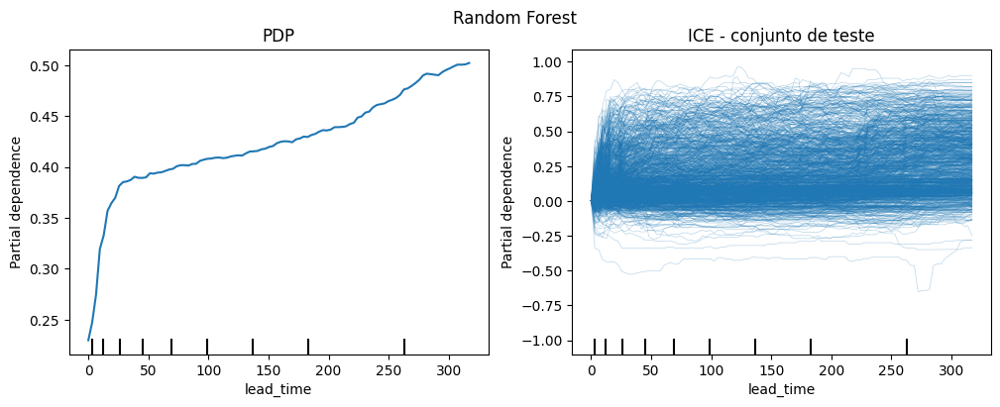

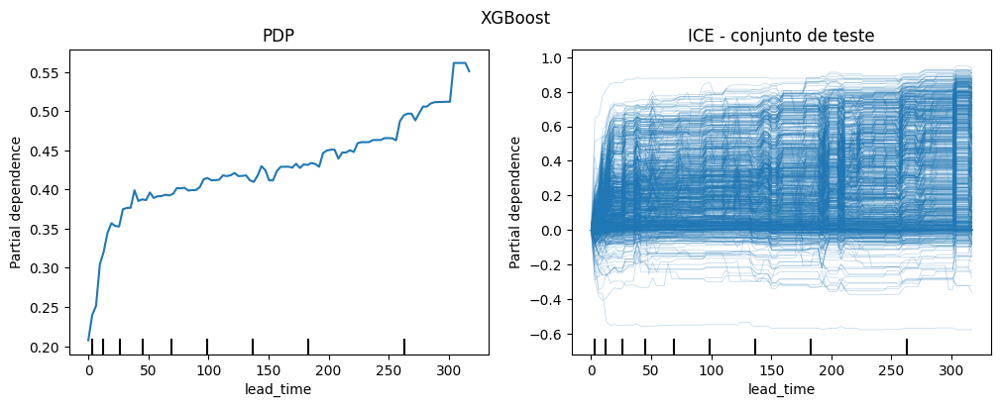

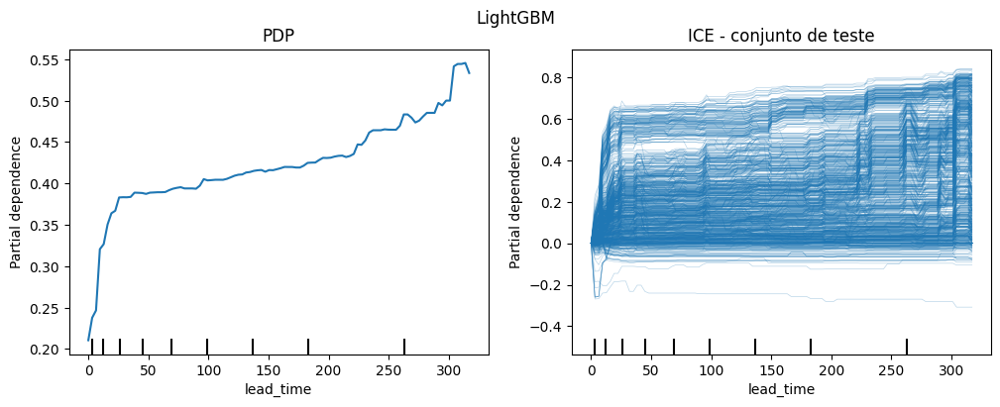

In [229]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("Random Forest")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["lead_time"], ax = axs[0], n_jobs = -1)

axs[1].set_title("ICE - conjunto de teste")
disp2 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["lead_time"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)


fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("XGBoost")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["lead_time"], ax = axs[0], n_jobs = -1)

axs[1].set_title("ICE - conjunto de teste")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["lead_time"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

fig, axs = plt.subplots(1,2, figsize=(12,4))

fig.suptitle("LightGBM")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["lead_time"], ax = axs[0], n_jobs = -1)

axs[1].set_title("ICE - conjunto de teste")
disp2 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["lead_time"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

Os modelos atribuem para a maioria das intâncias uma maior probabilidade de cancelamento quando maior o número de dias que se passaram entre a data de entrada da reserva no PMS e a data de chegada, entretanto é possivel observar no ICE que isto não é valido para algumas instâncias. 

#### arrival_date_week_number

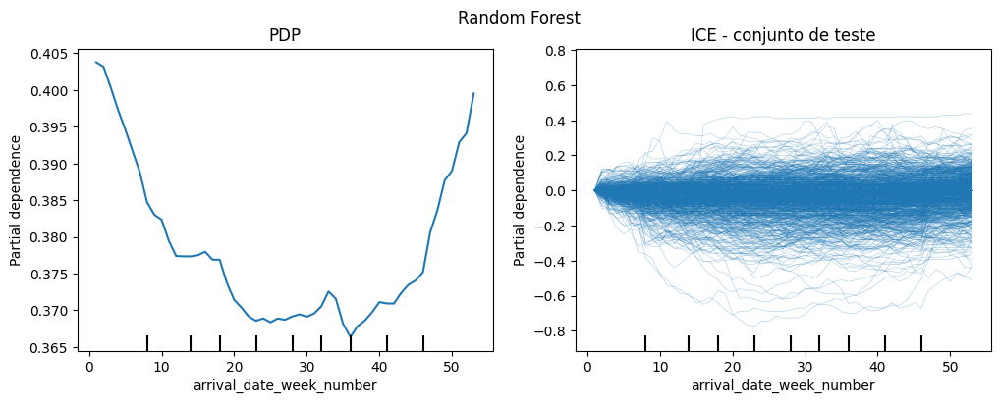

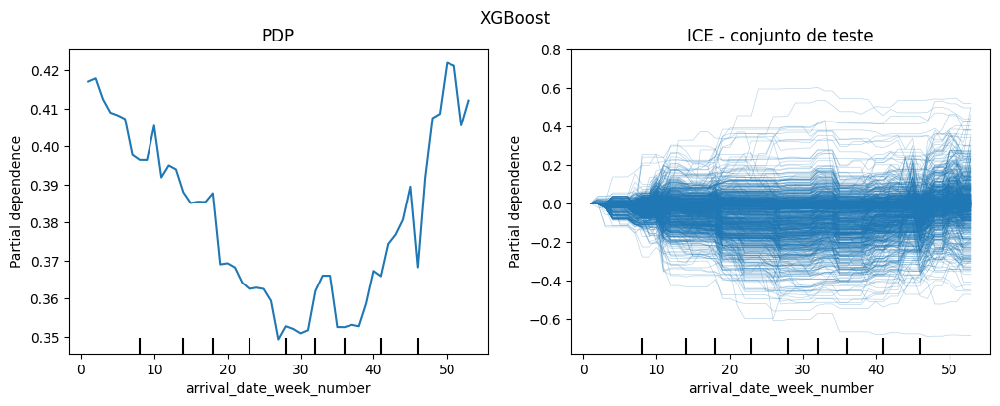

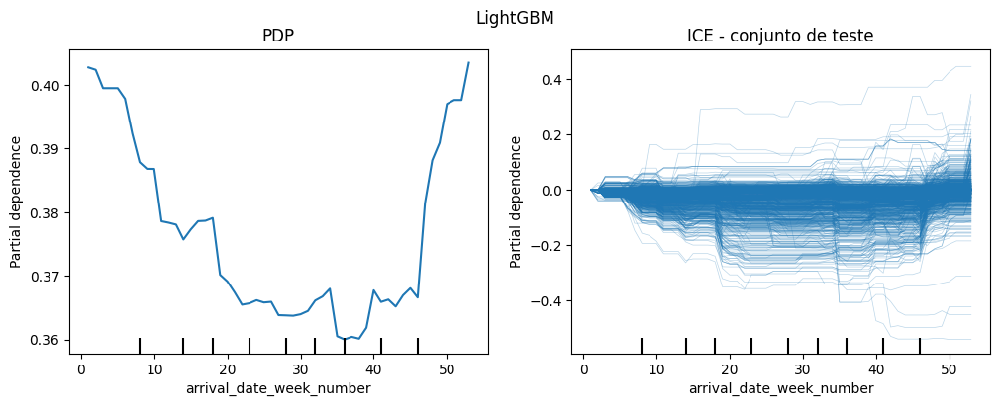

In [230]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("Random Forest")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["arrival_date_week_number"], ax = axs[0], n_jobs = -1)

axs[1].set_title("ICE - conjunto de teste")
disp2 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["arrival_date_week_number"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)


fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("XGBoost")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["arrival_date_week_number"], ax = axs[0], n_jobs = -1)

axs[1].set_title("ICE - conjunto de teste")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["arrival_date_week_number"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

fig, axs = plt.subplots(1,2, figsize=(12,4))

fig.suptitle("LightGBM")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["arrival_date_week_number"], ax = axs[0], n_jobs = -1)

axs[1].set_title("ICE - conjunto de teste")
disp2 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["arrival_date_week_number"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

Os modelos atribuem uma maior probabilidade para reservas com a data de chegada no inicio e no final do ano, porem é possivel observar no ICE que isto não é valido para algumas instâncias. No XGBoost existe dois pontos de grande queda de probabilidade para valores maiores que 40.

#### hotel_City

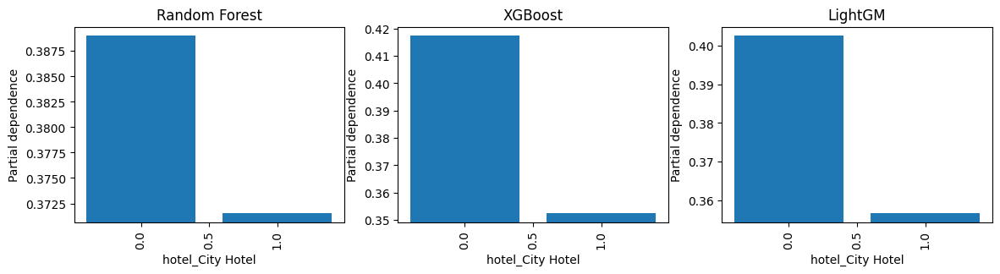

In [89]:
fig, axs = plt.subplots(ncols=3, figsize=(14,3))


axs[0].set_title("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["hotel_City Hotel"], n_jobs = -1, categorical_features =  ["hotel_City Hotel"], ax=axs[0])

axs[1].set_title("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["hotel_City Hotel"], n_jobs = -1, categorical_features =  ["hotel_City Hotel"], ax=axs[1])

axs[2].set_title("LightGM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["hotel_City Hotel"], n_jobs = -1, categorical_features =  ["hotel_City Hotel"], ax=axs[2])

Os modelos atribuiem uma menor probabilidade de cancelamento quando as reservas são realizadas em hoteis de cidades.

## Analisando a relação entre as variáveis

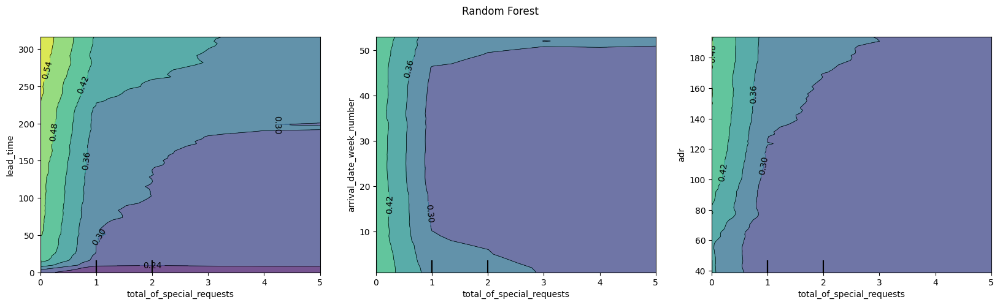

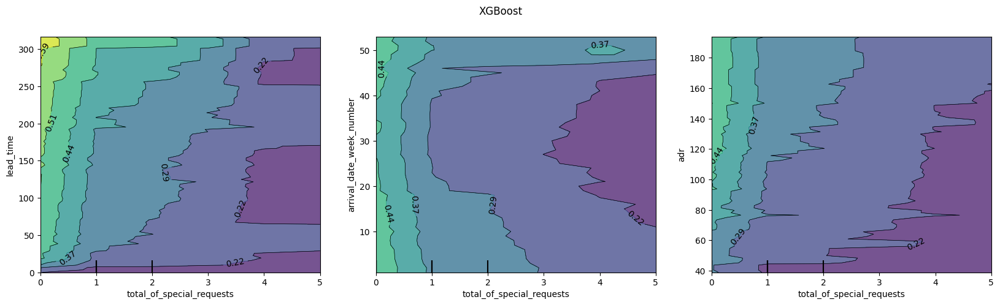

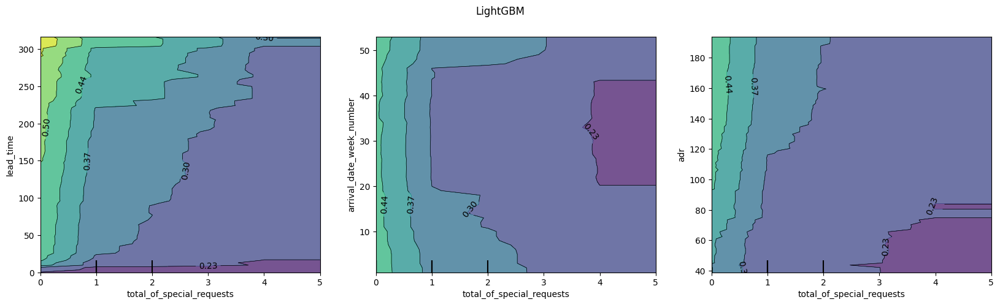

In [90]:
fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("total_of_special_requests", "lead_time"), ("total_of_special_requests", "arrival_date_week_number"), ("total_of_special_requests", "adr")], n_jobs = -1, ax=ax)

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("total_of_special_requests", "lead_time"), ("total_of_special_requests", "arrival_date_week_number"), ("total_of_special_requests", "adr")], n_jobs = -1, ax=ax)

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("total_of_special_requests", "lead_time"), ("total_of_special_requests", "arrival_date_week_number"), ("total_of_special_requests", "adr")], n_jobs = -1, ax=ax)

Nos gráficos "lead_time" x "total_of_special_requests" os três modelos atribuem uma maior probabilidade de cancelamento quando a variável "total_of_special_requests" (número de pedidos especiais) é 0 e o "lead_time" (Número de dias que se passaram entre a data de entrada da reserva no PMS e a data de chegada) é alto. Observa-se também que para valores do "lead_time" próximos a zero, a quantidade de "total_special_requests" não influencia na probabilidade no XGBoost e no LightGBM, entretanto no Random Forest, quando ambas variáveis são 0, uma maior probabilidade é atribuida.

Nos gráficos "total_of_special_requests" e "arrival_date_week_number" não foi observado uma relação clara entre as variáveis, entretanto o XGBoost e o LightGBM atribuem uma menor probabilidade quando a quantidade de pedidos especiais é maior do que 3 para o XGBoost e maior do que 4 para o LightGBM e a data de chegada é no meio do ano, o que não ocorre no Random Forest. Outro ponto a ser observado é que para o Random Forest e o LightGBM, quando o "total_of_special_requests" é 0, mudanças no valor do "arrival_date_week_number" não afetam a probabilidade, porem no XGBoost a probabilidade é reduzida quando o valor é 30 por exemplo.

Para o "total_of_special_requests" e "adr" o LightGBM atribui uma menor probabilidade quando o valor de "adr" é menor que 80 (também possui uma pequena região de menor probabilidade acima) e o "total_of_special_requests" é maior do que 3. No XGBoost essa região de menor probabilidade é maior, estando presente para valores próximos a 40 no "adr" quando o valor do "total_of_special_requests" é maior que ou igual a 1 e conforme o valor de "total_of_special_requests" aumenta essa região também aumenta, passando a incluir valores maiores de "adr". Já no Random Forest, esta região de menor probabilidade (representada em roxo mais escuro nos gráficos do LightGBM e do XGBoost) não se faz presente e valores maiores do que 3 no "total_of_special_requests" não afetam a probabilidade. 

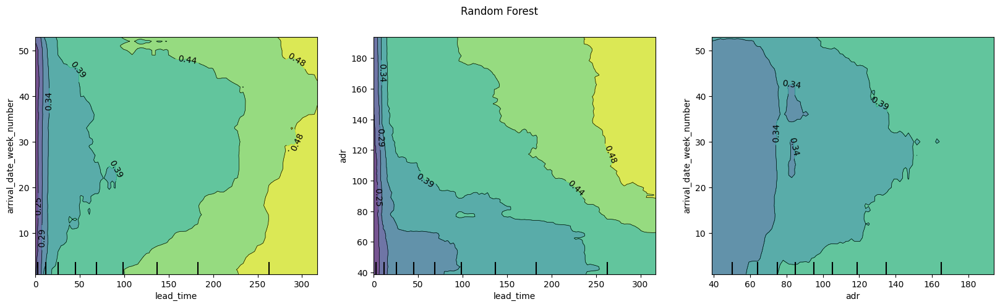

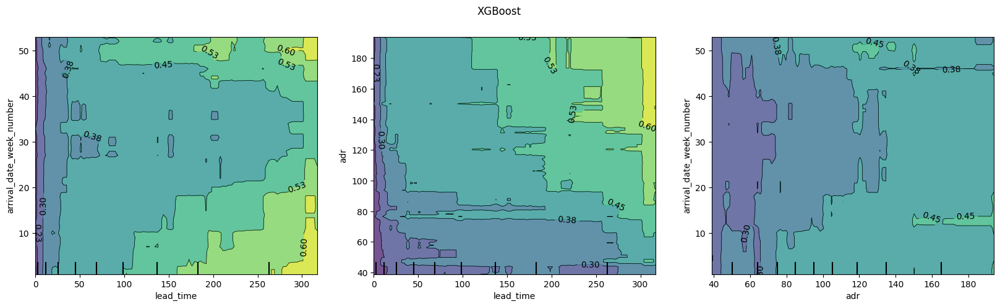

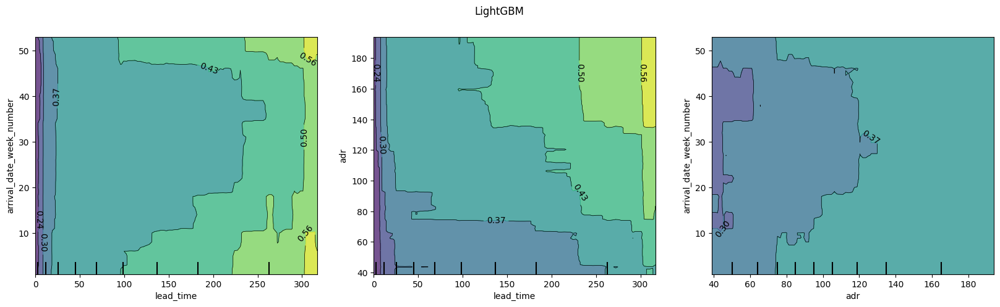

In [257]:
fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("lead_time", "arrival_date_week_number"), ("lead_time", "adr"), ("adr", "arrival_date_week_number")], n_jobs = -1, ax=ax)

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("lead_time", "arrival_date_week_number"), ("lead_time", "adr"), ("adr", "arrival_date_week_number")], n_jobs = -1, ax=ax)

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("lead_time", "arrival_date_week_number"), ("lead_time", "adr"), ("adr", "arrival_date_week_number")], n_jobs = -1, ax=ax)

Ao observar os gráficos do modelo XGBoost, nota-se que as regiões com mudanças de probabilidade não são tão definidas quanto no LightGBM e no Random Forest, existem algumas pequenas regiões isoladas em todos os gráficos.

Ao analisar os gráfico "arrival_date_week_number" e "lead_time" verifica-se que para valores de "lead_time" próximos a 0, o "arrival_date_week_number" não influência na probabilidade no XGBoost e no LightGBM, no Random Forest existe uma maior probabiliade para valores acima de 50, ou seja, no final do ano. Observa-se regiões de menor probabilidade para valores intermediarios no "arrival_date_week_number" e ocorre um aumento para valores maiores de "lead_time".

Nos gráficos "adr" e "lead_time" para valores proximos a 0 de "lead_time" existem 2 regiões no Random Forest e no XGBoost, uma de menor probabilidade para valores abaixo de 120 de "adr" e uma outra com uma probabilidade maior de cancelamento para valores acima de 120. No LightGBM, para valores próximos a 0 do "lead_time", o "adr" tem menor influência na alteração da probabilidade. Para valores maiores de "lead_time", observa-se uma relação entre as variáveis, quanto maiores os valores, maior a probabilidade.

A presença de menores probablidades para valores intermediarios de "arrival_date_week_number" também esta presente nos gráficos "arrival_date_week_number" e "adr", valores maiores de "adr" aumentam esta probabilidade. No XGBoost existem certas regiões isoladas com uma maior probabiliade que não estão presentes nos gráficos dos outros modelos.

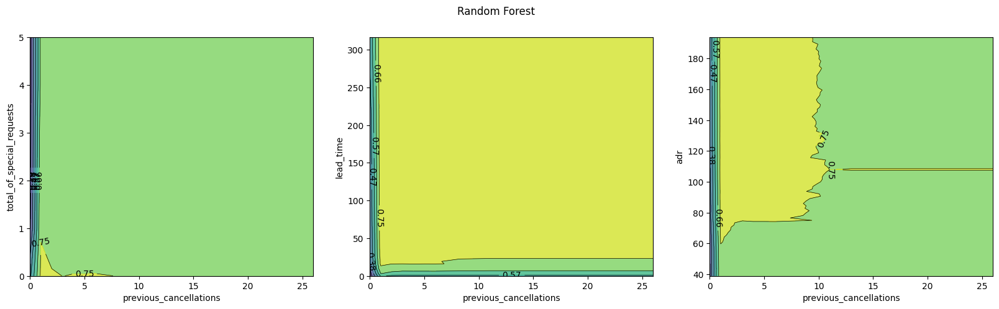

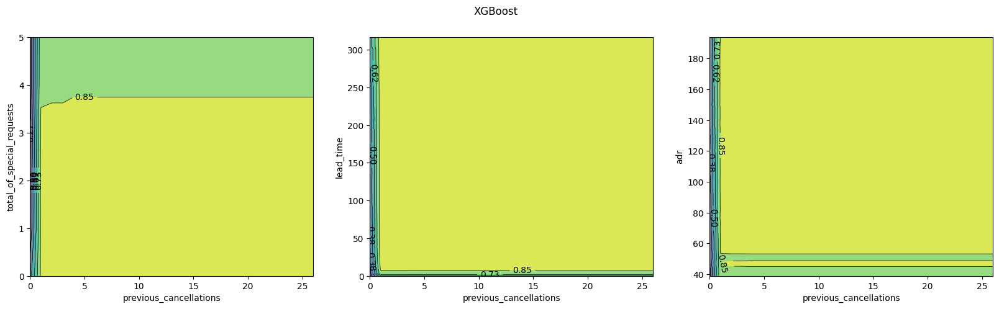

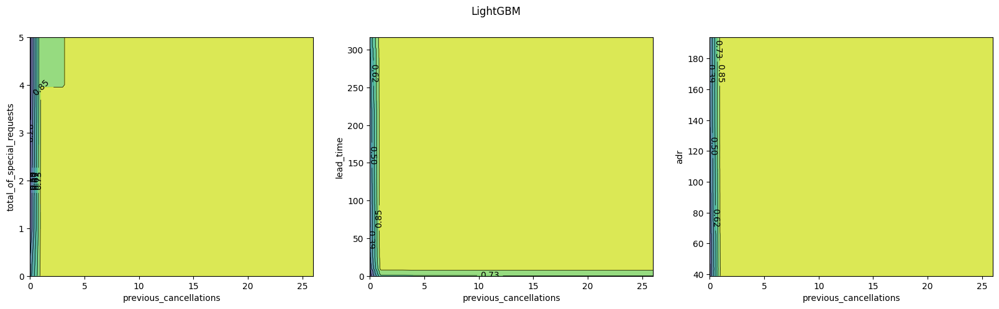

In [264]:
fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("previous_cancellations", "total_of_special_requests"), ("previous_cancellations", "lead_time"), ("previous_cancellations", "adr")], n_jobs = -1, ax=ax)

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("previous_cancellations", "total_of_special_requests"), ("previous_cancellations", "lead_time"), ("previous_cancellations", "adr")], n_jobs = -1, ax=ax)

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("previous_cancellations", "total_of_special_requests"), ("previous_cancellations", "lead_time"), ("previous_cancellations", "adr")], n_jobs = -1, ax=ax)

A váriavel "previous_cancellations" não possui uma clara relação com as outras variáveis, sendo verificada uma influência significativa na probabilidade apenas no gráfico "adr" e "previous_cancellations" do Random Forest onde para valores acima de 60 do "adr" o "previous_cancellations" maior do que 10 acarreta em uma maior probabilidade de cancelamento.

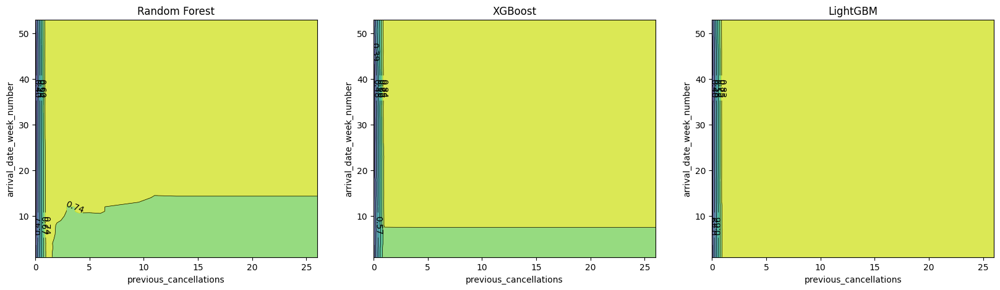

In [265]:
fig, axs = plt.subplots(figsize=(20, 5), ncols=3)

axs[0].set_title("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("previous_cancellations", "arrival_date_week_number")], n_jobs = -1, ax=axs[0], categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient"])

axs[1].set_title("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("previous_cancellations", "arrival_date_week_number")], n_jobs = -1, ax=axs[1], categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient"])

axs[2].set_title("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("previous_cancellations", "arrival_date_week_number")], n_jobs = -1, ax=axs[2], categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient"])

Támbem não foi possivel identificar uma relação da variável "previous_cancellations" com a "arrival_date_week_number".

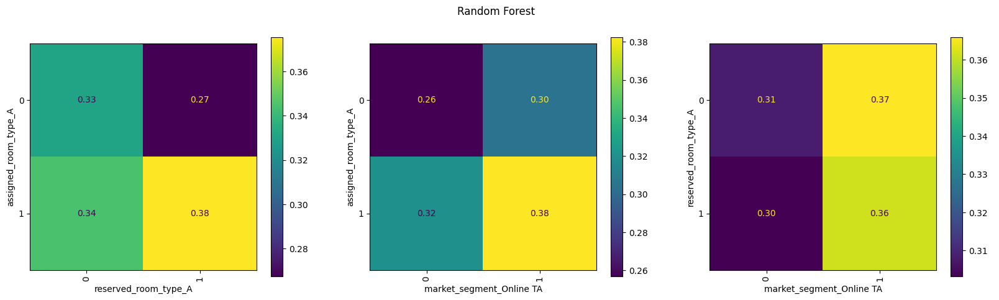

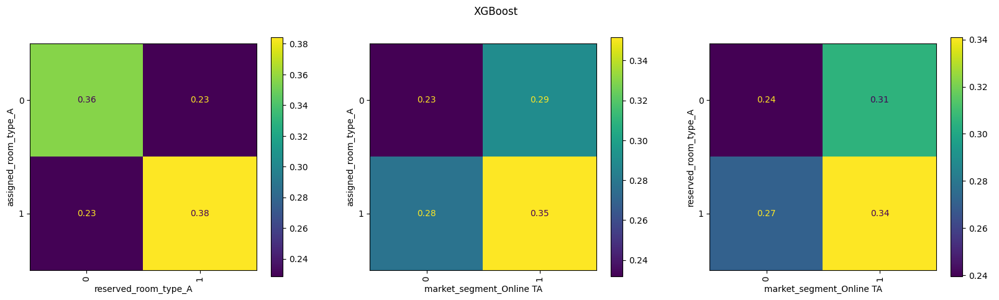

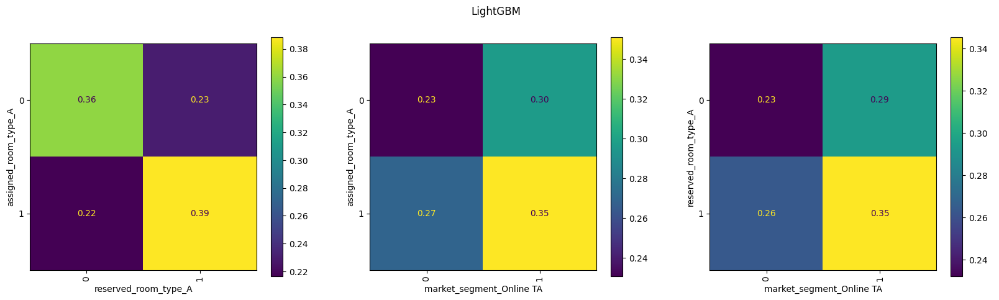

In [97]:
fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("assigned_room_type_A", "reserved_room_type_A"), ("assigned_room_type_A", "market_segment_Online TA"), ("reserved_room_type_A", "market_segment_Online TA")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("assigned_room_type_A", "reserved_room_type_A"), ("assigned_room_type_A", "market_segment_Online TA"), ("reserved_room_type_A", "market_segment_Online TA")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("assigned_room_type_A", "reserved_room_type_A"), ("assigned_room_type_A", "market_segment_Online TA"), ("reserved_room_type_A", "market_segment_Online TA")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A"])

Nos gráficos "assigned_room_type_A" e "reserved_room_type_A", o XGBoost e o LightGBM atribuem uma menor probabilidade de cancelamento quando as variáveis são diferentes (o quarto atribuido é diferente do quarto reservado), já o Random Forest, quando o "assigned_room_type_A" é 1 e o "reserved_room_type_A" é 0 a probabilidade atribuida é maior do que quando "assigned_room_type_A" e o "reserved_room_type_A" são 0, o que não ocorre no outros modelos. Os três modelos atribuem uma maior probabiliade quando o "assigned_room_type_A" e o "reserved_room_type_A" é 1, ou seja, o foi reservado um quarto do tipo A e foi atribuido um quarto do tipo A.

Ao analisar os gráficos "assigned_room_type_A" e "market_segment_Online TA", os três modelos atribuem a menor probabiliade quando ambos são 0 e a maior probabilidade de cancelamento quando ambos são 1.

O Random Forest tambem possui um comportamento diferentes dos demais no gráfico "reserved_room_type_A" e "market_segment_Online TA", enquanto o XGBoost e o LighGBM atribuem a menor probabilidade quando ambos são 0 e a maior quando ambos são 1, o Random Forest atribue a menor probabilidade quando o "reserved_room_type_A" é 1 e o "market_segment_Online TA" é 0, e a maior probabilidade quando o "reserved_room_type_A" é  0 e o "market_segment_Online TA" é 1, contudo, a diferença entre a menor e a maior probabilidade é menor quando comparado com os demais modelos.

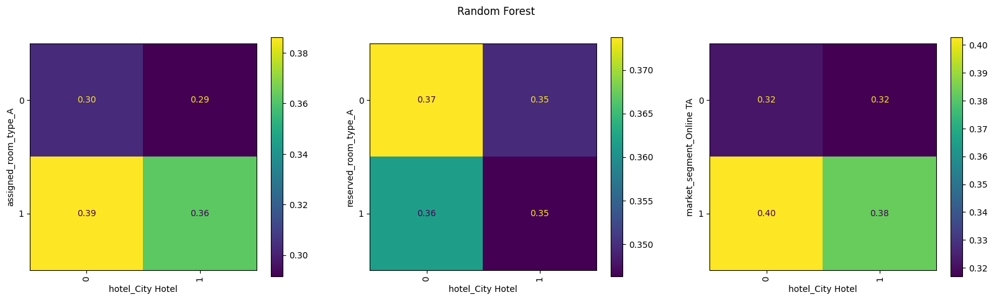

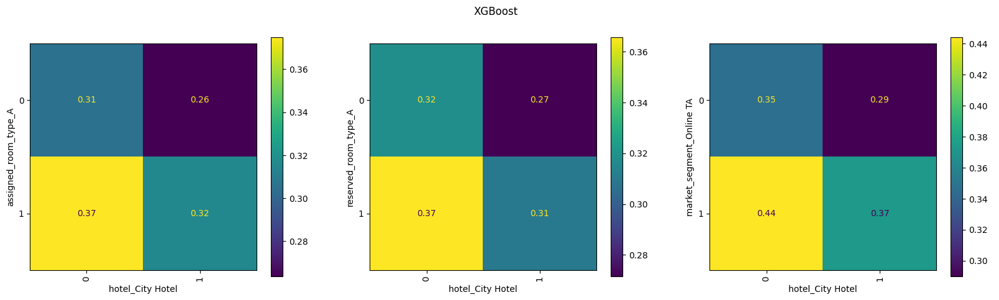

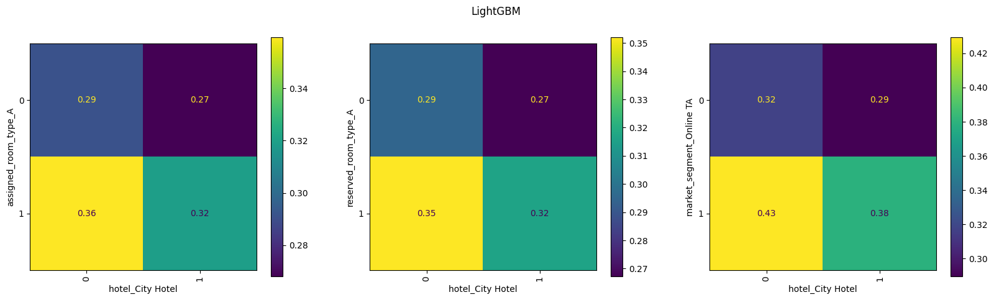

In [99]:
fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("assigned_room_type_A", "hotel_City Hotel"),("reserved_room_type_A", "hotel_City Hotel"), ("market_segment_Online TA", "hotel_City Hotel")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("XGBoost")
disp1 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("assigned_room_type_A", "hotel_City Hotel"),("reserved_room_type_A", "hotel_City Hotel"), ("market_segment_Online TA", "hotel_City Hotel")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("assigned_room_type_A", "hotel_City Hotel"),("reserved_room_type_A", "hotel_City Hotel"), ("market_segment_Online TA", "hotel_City Hotel")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A"])

Os três modelos atribuem uma maior probabilidade quando o "assigned_room_type_A" é 1 e o "hotel_City Hotel" é 0 e uma menor probabilidade quando o "assigned_room_type_A" é 0 e o "hotel_City Hotel" é 1.

Nos gráficos "reserved_room_type_A" e "hotel_City Hotel", observa-se que o XGBoost e o LightGBM atribuem uma maior probabilidade quando o "reserved_room_type_A" é 1 e o "hotel_City Hotel" é 0 e uma menor probabilidade quando o "reserved_room_type_A" é 0 e o "hotel_City Hotel" é 1, já no Random Forest, não fica o claro  o relacionamento entre estas variáveis, uma vez que diferença entre as probabilidades é pequena.

Da mesma forma, também não é possivel observar uma relação entre as variáveis "market_segment_Online TA" e "hotel_City Hotel" no Random Forest, já o XGBoost e o LightGBM, atribuem uma maior probabilidade quando o "market_segment_Online TA" é 1 e o "hotel_City Hotel" é 0, e uma menor probabilidade quando o "market_segment_Online TA" é 0 e o "hotel_City Hotel" é 1.

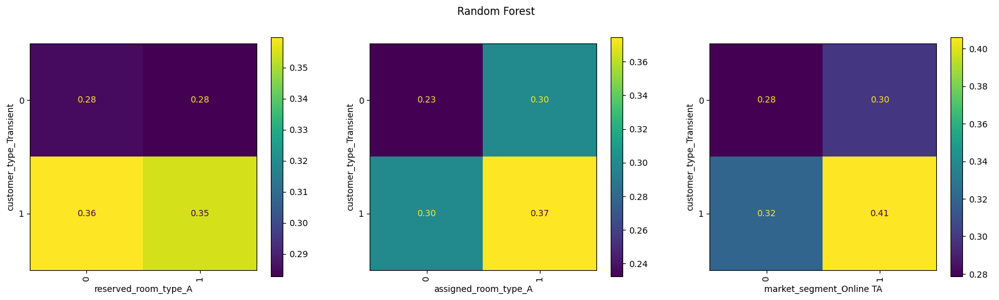

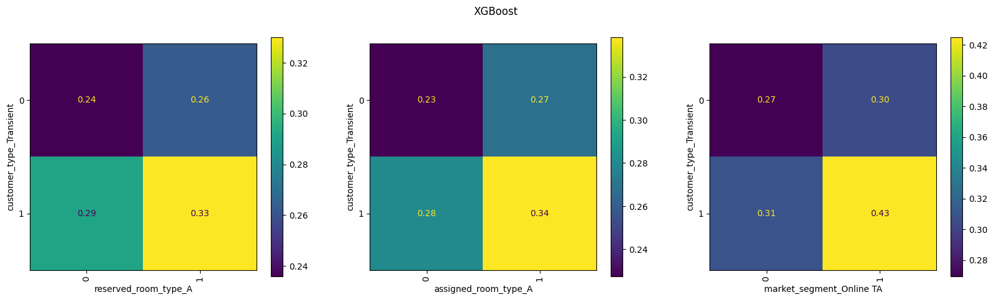

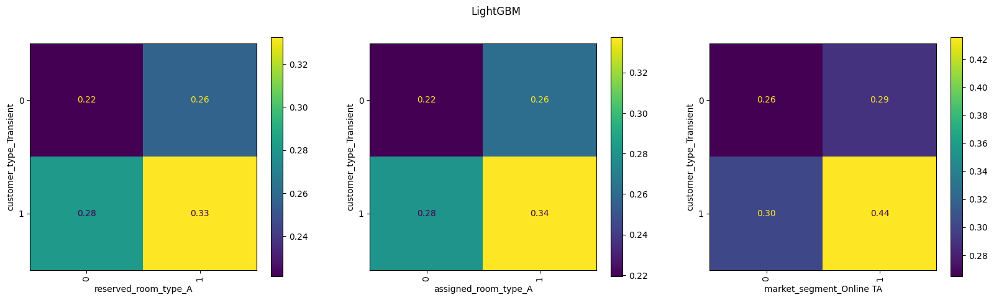

In [101]:
fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("customer_type_Transient", "reserved_room_type_A"), ("customer_type_Transient", "assigned_room_type_A"), ("customer_type_Transient", "market_segment_Online TA")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("customer_type_Transient", "reserved_room_type_A"), ("customer_type_Transient", "assigned_room_type_A"), ("customer_type_Transient", "market_segment_Online TA")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("customer_type_Transient", "reserved_room_type_A"), ("customer_type_Transient", "assigned_room_type_A"), ("customer_type_Transient", "market_segment_Online TA")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient"])

O Random Forest não apresenta uma relação clara entre as variáveis "customer_type_Transient" e "reserved_room_type_A", já o XGBoost e o LightGBM atribuem uma maior probabilidade quando ambos são 1 e uma menor probabilidade quando ambos são 0.

Ns variáveis "customer_type_Transient" e "reserved_room_type_A" os três model atribuem uma maior probabilidade quando ambas varáveis são 1 e uma menor probabilidade quando são 0, o mesmo ocorre para as variáveis "customer_type_Transient" e "market_segment_Online TA".

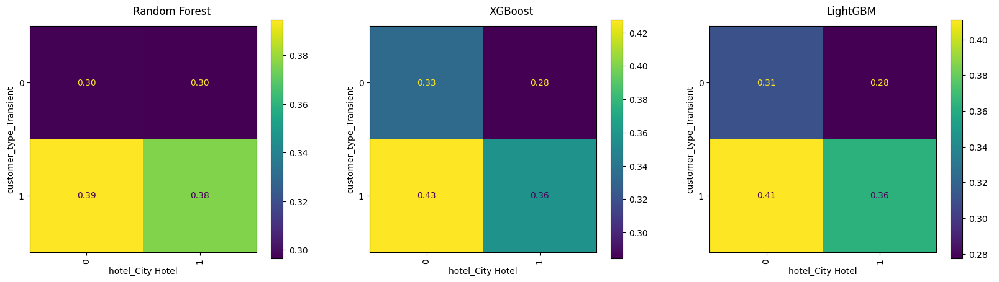

In [106]:
fig, axs = plt.subplots(figsize=(20, 5), ncols=3)

axs[0].set_title("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("customer_type_Transient", "hotel_City Hotel")], n_jobs = -1, ax=axs[0], categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient"])

axs[1].set_title("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("customer_type_Transient", "hotel_City Hotel")], n_jobs = -1, ax=axs[1], categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient"])

axs[2].set_title("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("customer_type_Transient", "hotel_City Hotel")], n_jobs = -1, ax=axs[2], categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient"])

A relação entre as variáveis "customer_type_Transient" e "hotel_City Hotel" não fica clara no Random Forest, porem o XGBoost e o LightGBM atribuiem uma maior probabilidade quando o "customer_type_Transient" é 1 e "hotel_City Hotel" é 0 e uma menor quando "customer_type_Transient" é 0 e o "hotel_City Hotel" é 1.

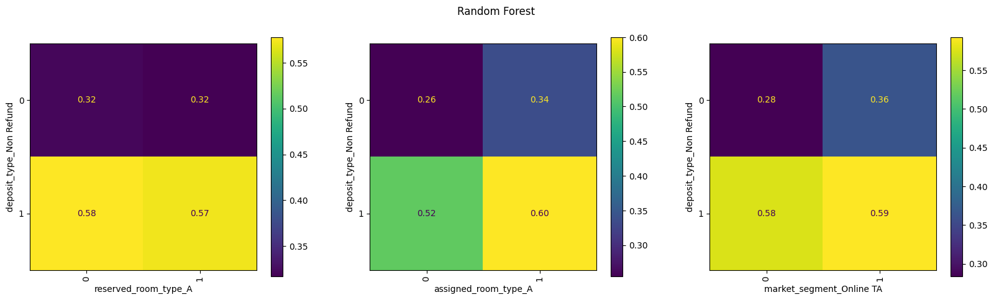

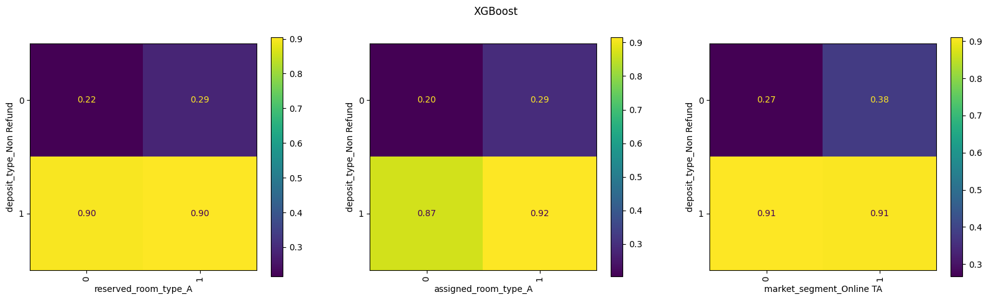

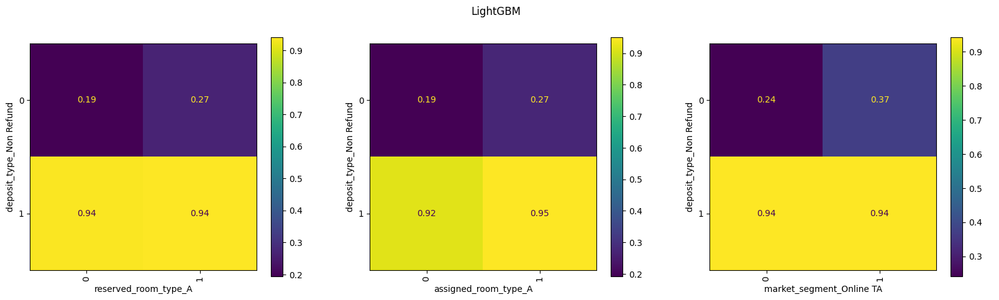

In [232]:
fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("deposit_type_Non Refund", "reserved_room_type_A"), ("deposit_type_Non Refund", "assigned_room_type_A"), ("deposit_type_Non Refund", "market_segment_Online TA")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient", "deposit_type_Non Refund"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("deposit_type_Non Refund", "reserved_room_type_A"), ("deposit_type_Non Refund", "assigned_room_type_A"), ("deposit_type_Non Refund", "market_segment_Online TA")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient", "deposit_type_Non Refund"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("deposit_type_Non Refund", "reserved_room_type_A"), ("deposit_type_Non Refund", "assigned_room_type_A"), ("deposit_type_Non Refund", "market_segment_Online TA")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient", "deposit_type_Non Refund"])



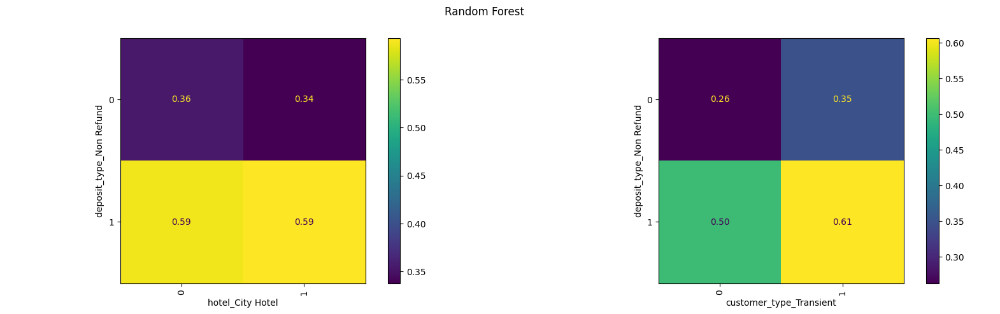

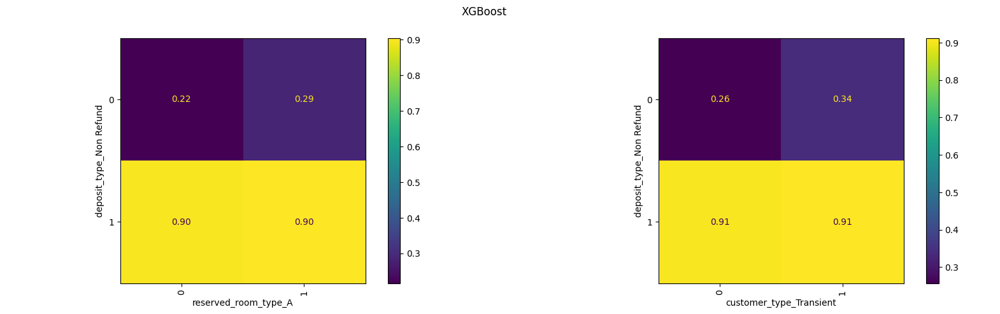

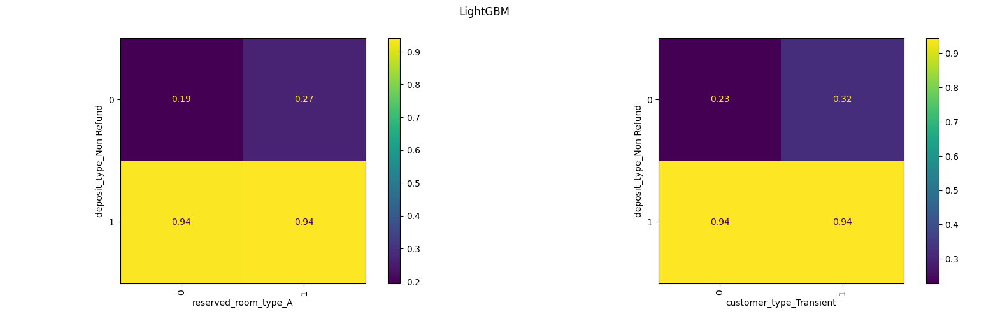

In [268]:
fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("deposit_type_Non Refund", "hotel_City Hotel"), ("deposit_type_Non Refund", "customer_type_Transient"),], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient", "deposit_type_Non Refund"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("deposit_type_Non Refund", "reserved_room_type_A"), ("deposit_type_Non Refund", "customer_type_Transient")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient", "deposit_type_Non Refund"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("deposit_type_Non Refund", "reserved_room_type_A"), ("deposit_type_Non Refund", "customer_type_Transient")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient", "deposit_type_Non Refund"])

A única relação clara observada com a variável "deposit_type_Non Refund" ocorre com a variável "customer_type_Transiente" no Random Forest, onde o modelo atribui a maior probabilidade quando ambas possuem o valor 1 e a menor quando ambas possuem o valor 0.

## Analisando instâncias com o LIME

In [107]:
from lime.lime_tabular import LimeTabularExplainer

Resetando os indices para facilitar a seleção das instâncias

In [188]:
X_test_temp = X_test.reset_index(drop=True)
X_test_temp_label = X_test_temp.copy()
X_test_temp_label["label"] = y_test.values

In [115]:
cat = ['dist_channel_Corporate',
       'dist_channel_Direct', 'dist_channel_GDS', 'dist_channel_TA/TO',
       'dist_channel_Undefined', 'hotel_City Hotel', 'hotel_Resort Hotel',
       'customer_type_Contract', 'customer_type_Group',
       'customer_type_Transient', 'customer_type_Transient-Party', 'meal_BB',
       'meal_FB', 'meal_HB', 'meal_SC', 'meal_Undefined',
       'market_segment_Aviation', 'market_segment_Complementary',
       'market_segment_Corporate', 'market_segment_Direct',
       'market_segment_Groups', 'market_segment_Offline TA/TO',
       'market_segment_Online TA', 'reserved_room_type_A',
       'reserved_room_type_B', 'reserved_room_type_C', 'reserved_room_type_D',
       'reserved_room_type_E', 'reserved_room_type_F', 'reserved_room_type_G',
       'reserved_room_type_H', 'reserved_room_type_L', 'reserved_room_type_P',
       'assigned_room_type_A', 'assigned_room_type_B', 'assigned_room_type_C',
       'assigned_room_type_D', 'assigned_room_type_E', 'assigned_room_type_F',
       'assigned_room_type_G', 'assigned_room_type_H', 'assigned_room_type_I',
       'assigned_room_type_K', 'assigned_room_type_L', 'assigned_room_type_P',
       'deposit_type_No Deposit', 'deposit_type_Non Refund',
       'deposit_type_Refundable']

In [189]:
cat_idx = []

for idx, col in enumerate(X_test_temp.columns):
    if col in cat:
        cat_idx.append(idx)

Criando o explicador

In [196]:
explainer = LimeTabularExplainer(
    training_data=X_train.values,
    mode="classification",
    training_labels=y_train,
    feature_names=X_train.columns,
    categorical_features=cat_idx,
    random_state=42
)

Primeiramente serão analisados dois exemplos onde as variáveis "assigned_room_type_A" e "reserved_room_type_A" possuem valores 1, dado que são variáveis importantes para a classe 1 de acordo com o PFI.

In [206]:
X_test_temp_label[(X_test_temp_label["assigned_room_type_A"] == 1) & (X_test_temp_label["reserved_room_type_A"] == 1)& (X_test_temp_label["label"] == 1)]

,lead_time,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,...,assigned_room_type_G,assigned_room_type_H,assigned_room_type_I,assigned_room_type_K,assigned_room_type_L,assigned_room_type_P,deposit_type_No Deposit,deposit_type_Non Refund,deposit_type_Refundable,label
1,82,29,16,0,3,2,0,0,0,0,...,0,0,0,0,0,0,1,0,0,1
3,162,18,6,2,1,1,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
6,46,10,4,0,2,2,0,0,0,0,...,0,0,0,0,0,0,1,0,0,1
7,102,42,16,0,2,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
11,305,45,4,1,2,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39381,86,10,9,0,3,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
39382,104,20,15,1,2,1,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
39390,275,23,4,1,1,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
39392,50,43,24,0,1,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1


In [236]:
i = 1
exp = explainer.explain_instance(X_test_temp.iloc[i], rf_model.predict_proba, num_features = 15)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [221]:
exp = explainer.explain_instance(X_test_temp.iloc[i], xgb_model.predict_proba, num_features = 15)
exp.show_in_notebook()

In [222]:
exp = explainer.explain_instance(X_test_temp.iloc[i], lgb_model.predict_proba, num_features = 15)
exp.show_in_notebook()

O Random Forest prediz uma probabilidade bem proxima de 0.5, enquanto XGBoost atribui uma probabilidade de 0.68 e o LightGBM uma probabilidade de 0.61, essa probabilidade baixa pode ser explicada devido o valor de duas variáveis contribuirem bastante para a classe 0, essas variáveis são a "deposit_type_Non Refund" e a "previous_cancellations". Embora na analise do PFI essas variáveis não ocasionaram uma grande diminuição da acurácia, na analise utilizando o PDP foi verificado que o valor assumido por ambas contribui bastante na probabilidade, o que é confirmado pelo Lime. No Random Forest uma terceira variável também possui uma boa contribuição para a classe 0, a "deposit_type No Deposit".

Apesar das variáveis "assigned_room_type_A" e "reserved_room_type_A" terem mostrado bastante importância no PFI, estas possuem uma contribuição não tão alta para a probabilidade da classe 1 nessa instância, sendo "required_car_parking_spaces" a variável que mais contribuiu para a probabilidade desta classe.


Agora será analisado outra instância que possue as variáveis "assigned_room_type_A" e "reserved_room_type_A" fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("Random Forest")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, [("deposit_type_Non Refund", "hotel_City Hotel"), ("deposit_type_Non Refund", "customer_type_Transient"),], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient", "deposit_type_Non Refund"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("XGBoost")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, [("deposit_type_Non Refund", "reserved_room_type_A"), ("deposit_type_Non Refund", "customer_type_Transient")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient", "deposit_type_Non Refund"])

fig, ax = plt.subplots(figsize=(20, 5))
fig.suptitle("LightGBM")
disp3 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, [("deposit_type_Non Refund", "reserved_room_type_A"), ("deposit_type_Non Refund", "customer_type_Transient")], n_jobs = -1, ax=ax, categorical_features =  ["market_segment_Online TA", "hotel_City Hotel", "assigned_room_type_A", "reserved_room_type_A", "customer_type_Transient", "deposit_type_Non Refund"])iguais a 1.

In [238]:
i = 11
exp = explainer.explain_instance(X_test_temp.iloc[i], rf_model.predict_proba, num_features = 15)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [239]:
exp = explainer.explain_instance(X_test_temp.iloc[i], xgb_model.predict_proba, num_features = 15)
exp.show_in_notebook()

In [240]:
exp = explainer.explain_instance(X_test_temp.iloc[i], lgb_model.predict_proba, num_features = 15)
exp.show_in_notebook()

Nesta instância, todos os modelos atribuiram uma probabilidade de 100% e novamente as duas variáveis que se destacaram pela alta influência na probabilidade foram a "previous_cancellations" e o "deposit_type_Non Refund", desta vez, a variável "deposit_type_Non Refund" por possuir o valor 1, contribui para a classe 1. No Random Forest, estas variáveis apresentam uma menor contribuição.

Novamente as variáveis "assigned_room_type_A" e "reserved_room_type_A" não tiveram grandes contribuições para a classe 1, o que pode indicar que devida a forma que o PFI funciona, e o uso do One Hot Enconding, a importância obtida não reflete a importância real destas variáveis. 

A variável "required_car_parking_spaces" aparece novamente com uma boa contribuição para a classe 1, se mostrando mais importânte do que o exibido pelo PFI.

Agora será escolhida para analise uma instância um alto valor de "lead_time" e o baixo de "total_of_special_requests" uma vez que de acordo com o PDP esta configuração acarreta em um aumento na probabilidade e ambas se mostrando variáveis importantes para a classe 0 na analise do PDP

In [256]:
X_test_temp_label[(X_test_temp_label["lead_time"] >= 300) & (X_test_temp_label["total_of_special_requests"] == 0)]

,lead_time,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,...,assigned_room_type_G,assigned_room_type_H,assigned_room_type_I,assigned_room_type_K,assigned_room_type_L,assigned_room_type_P,deposit_type_No Deposit,deposit_type_Non Refund,deposit_type_Refundable,label
11,305,45,4,1,2,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
18,323,36,5,1,1,2,0,0,0,1,...,0,0,0,0,0,0,0,1,0,1
24,398,33,11,0,1,1,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
26,360,42,12,1,1,2,0,0,0,1,...,0,0,0,0,0,0,0,1,0,1
27,378,45,1,0,2,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39260,482,45,3,0,2,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
39320,385,43,19,1,4,2,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
39337,437,19,2,1,2,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
39349,468,43,20,0,2,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1


In [253]:
i = 39320
exp = explainer.explain_instance(X_test_temp.iloc[i], rf_model.predict_proba, num_features = 15)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [254]:
exp = explainer.explain_instance(X_test_temp.iloc[i], xgb_model.predict_proba, num_features = 15)
exp.show_in_notebook()

In [255]:
exp = explainer.explain_instance(X_test_temp.iloc[i], lgb_model.predict_proba, num_features = 15)
exp.show_in_notebook()

Analisando outra instância com o mesmo valor de "lead_time" e "total_of_special_requests".

In [269]:
i = 27
exp = explainer.explain_instance(X_test_temp.iloc[i], rf_model.predict_proba, num_features = 15)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [270]:
exp = explainer.explain_instance(X_test_temp.iloc[i], xgb_model.predict_proba, num_features = 15)
exp.show_in_notebook()

In [271]:
exp = explainer.explain_instance(X_test_temp.iloc[i], lgb_model.predict_proba, num_features = 15)
exp.show_in_notebook()

Assim como nas instâncias anteriores, as variáveis "previous_cancellations" e a "deposit_type_Non Refund" são as variáveis mais importâmtes em todos os modelos de arco com o LIME.

As variáveis "lead_time" e "total_of_special_requests" de fato contribuem para a probabilidade da classe 1 com estes valores, porem mesmo escolhendo a configuração que de acordo com o PDP daria a maior contribuição para a probabilidade de cancelamento, pelo LIME nestas instâncias, observa-se que a contruibuição é modesta.

Outra variável a ser observada é a "required_car_parking_spaces" que novamente possui uma boa importância.

### Partial Dependency Plot para a variável "required_car_parking_spaces"

A variável "required_car_parking_spaces" foi bastante utilizada pelo LIME para explicar a predição das instâncias, desta forma será analisado o PDP.

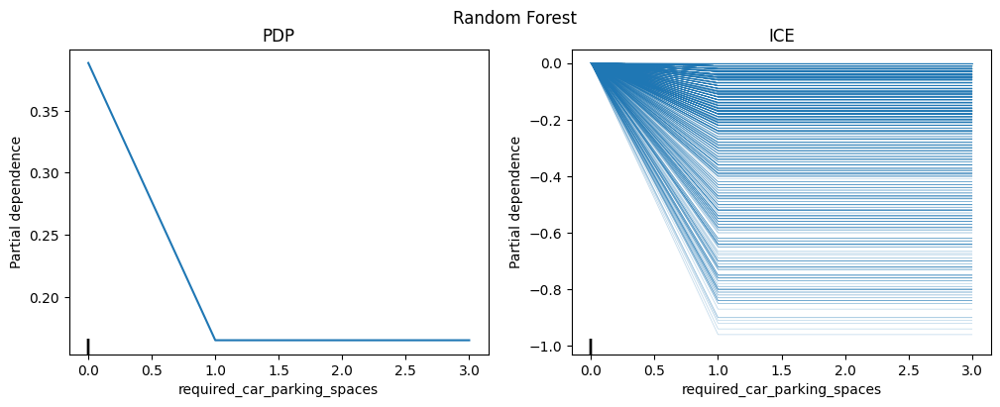

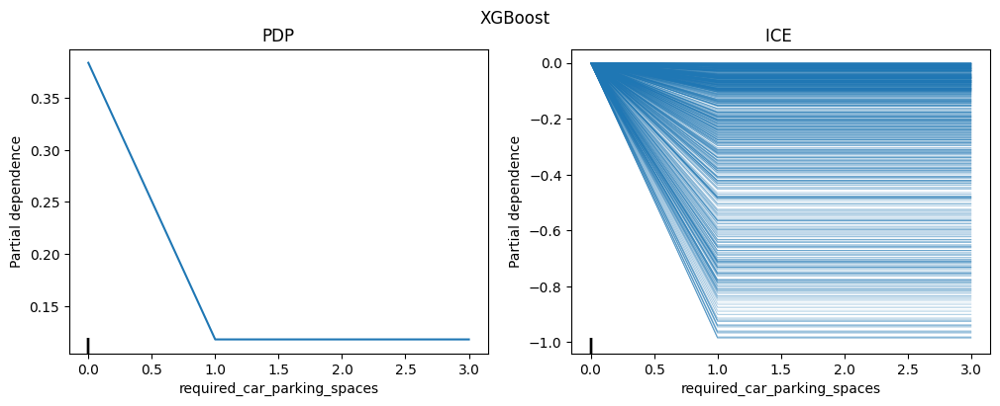

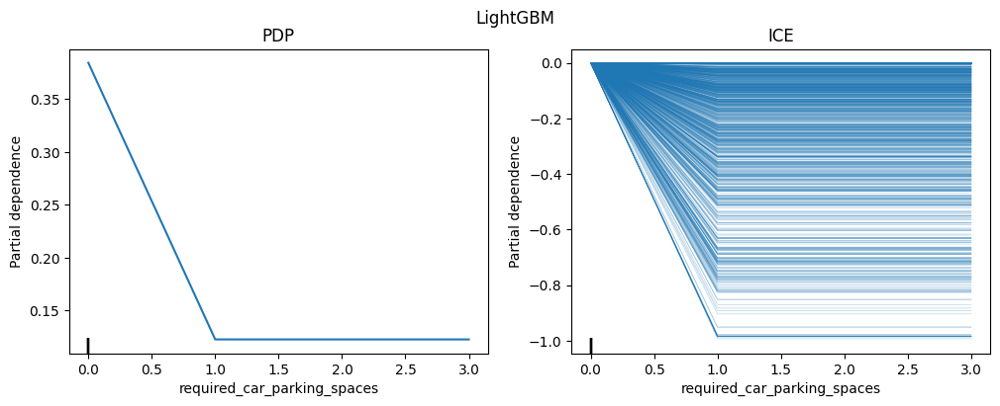

In [266]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("Random Forest")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["required_car_parking_spaces"], ax = axs[0], n_jobs = -1)
axs[1].set_title("ICE")
disp2 = PartialDependenceDisplay.from_estimator(rf_model, X_test, ["required_car_parking_spaces"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("XGBoost")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["required_car_parking_spaces"], ax = axs[0], n_jobs = -1)
axs[1].set_title("ICE ")
disp2 = PartialDependenceDisplay.from_estimator(xgb_model, X_test, ["required_car_parking_spaces"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)

fig, axs = plt.subplots(1,2, figsize=(12,4))
fig.suptitle("LightGBM")
axs[0].set_title("PDP")
disp1 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["required_car_parking_spaces"], ax = axs[0], n_jobs = -1)
axs[1].set_title("ICE")
disp2 = PartialDependenceDisplay.from_estimator(lgb_model, X_test, ["required_car_parking_spaces"], kind='individual', ax = axs[1], n_jobs = -1, centered=True)


No PDP, observa-se que quando o valor é 0, os modelos atribuem uma probabilidade maior de cancelamento, no ICE, algumas instâncias mostram uma enorme diferença na probabilidade ao alterar o valor para maior do que 0, o que pode explicar a importância dada a essa varável pelo LIME, entretanto para algumas instâncias, o valor desta variável não surte efeito.

# Conclusão

Ao realizar as análises ficou evidente a importância de utilizar diferentes metodos para interpretar os modelos, as variáveis "previous_cancellation" e "deposit_type_Non Refund", por exemplo, não aparentavam possuir muita importância de acordo com o PFI, entretanto a importância ficou evidente ao ser realizado analises com o PDP e o Lime, onde foi verificado que estas variáveis alteram bastante a probabilidade de cancelamento, esta importância também pode ser notada nos modelos Global Surrogate, onde a variável "deposit_type_Non Refund" foi utilizada como raiz nos três modelos, gerando um nó com entropia proxima a zero no primeiro nível.

As variáveis "assigned_room_type_A" e "reserved_room_type_A" foram apontadas como muito importantes para a classe 1 pelo PFI, entretanto ao ser analisado o PDP e o LIME, verificou-se que embora contribuam, essa contribuição é modesta, isto pode ter ocorrido devido ao One Hot Encoding e a forma que o PFI funciona, onde ao realizar a permutação dessas varáveis, gerou exemplos de cliente que reservaram ou foram atribuidos a dois quartos diferentes, o que não é possivel de ocorrer.

Com a analise das instâncias utilizando o LIME, foi observado a importância de uma variável que não tinha sido analisada até então, a "required_car_parking_spaces", que indica a quantidade de vagas no estacionamento solicitada pelo cliente, se demonstrando importânte nos três modelos.

Ao comparar o Random Forest, XGBoost e o LightGBM foi possivel observar como cada modelo utiliza cada variável, possuindo diferentes comportamentos para os mesmos valores. Para o XGBoost por exemplo, verificou-se  que as transições entre as probabilidades foram menos suaves, com a presença de "ilhas" nos gráficos do PDP. Já o Random Forest, modelo ao qual se obteve os melhores resultados, foi observado que este reduziu a importância de cada variável, com menores diferenças na probabilidade ao se alterar o valor das variáveis, como por exemplo a "deposit_type_Non Refund" e "previous_cancellation" que ao comparar os gráficos do PDP e do LIME, a contribuição na probabilidade é bem menor quando comparado ao XBoost e ao LightGBM. O LightGBM de forma geral teve um comportamente semelhando ao XGBoost com algumas pequenas diferenças, como por exemplo, as transições nos gráficos de PDP foram mais suaveis, sem as presenças das regiões ilhadas.